##  Gridded Model Verification

This script verifies output from a ML-based foundation model versus a
traditional NWP system for the atmospheric system. The defaults set at the top of
this script are tailored to the Alps-Clariden HPC system at CSCS.
- The NWP-model is called DANRA-forecasts and is initialised with the analysis. Only surface level data is available, and up to 18 h lead time.
- The ML-model is called Neural-LAM and is initialised from the DANRA reanalysis.
- The Ground Truth is the same deterministic DANRA reanalysis as was used to train the ML-model.
- The boundary data for both models is IFS HRES from ECMWF, where the NWP-model got 6 hourly boundary updates (?) and the ML model 12 hourly.

In [2]:
import random
from pathlib import Path

import cartopy.crs as ccrs
import cartopy.feature as cfeature
import dask
import matplotlib.pyplot as plt
from dask.distributed import LocalCluster, Client
import numpy as np
from dask.diagnostics import ProgressBar
import pandas as pd
import xarray as xr
from pysteps.verification.salscores import sal  # requires scikit-image
from scipy.stats import kurtosis, skew, wasserstein_distance
from scores.categorical import ThresholdEventOperator as TEO
from scores.continuous import (
    mae,
    mean_error,
    mse,
    rmse,
)
from scores.continuous.correlation import pearsonr
from scores.spatial import fss_2d

Pysteps configuration file found at: /home/joel/miniconda3/envs/mllam/lib/python3.10/site-packages/pysteps/pystepsrc



**--------> Enter all your user settings in the cell below. <--------**

In [ ]:
### DEFAULTS ###
# This config will be applied to the data before any plotting. The data will be
# sliced and indexed according to the values in this config.The whole analysis and
# plotting will be done on the reduced data.

# IF YOUR DATA HAS DIFFERENT DIMENSIONS OR NAMES, PLEASE ADJUST THE CELLS BELOW
# MAKE SURE THE XARRAY DATASETS LOOK OKAY BEFORE RUNNING CHAPTER 1-4

# This path should point to the data that was used to train the model (default is mdp-datastore)
PATH_GROUND_TRUTH = "danra_test_gt.zarr"
# This path should point to the NWP forecast data in zarr format
PATH_NWP = "danra_nwp_forecasts.zarr"
# This path should point to the ML forecast data in zarr format (e.g. produced by neural-lam in `eval` mode)
PATH_ML = "48h_eval_test_7deg_rect_hi4_2867.zarr"
# This path should point to the boundary data in zarr format (default is MDP-datastore)
PATH_BOUNDARY = "ifs_test_boundary.zarr"

# elapsed forecast duration in steps for the forecast - [0] refers to the first forecast step at t+1
# this should be a list of integers
ELAPSED_FORECAST_DURATION = list(range(16))
ELAPSED_FORECAST_DURATION_SHORT = list(range(6)) # 18 h, matching NWP forecasts
ELAPSED_FORECAST_DURATION_PLOT = [1,3,5] # ELS to plot

# Select specific start_times for the forecast. This is the start and end of
# a slice in xarray. The start_time is included, the end_time is excluded.
# This should be a list of two strings in the format "YYYY-MM-DDTHH:MM:SS"
# Should be handy to evaluate certain dates, e.g. for a case study of a storm
#START_TIMES = ["2020-02-07T00:00:00", "2020-02-10T00:00:00"] # 7 init times, ~1% of full year
START_TIMES = ["2019-10-30T00:00", "2020-10-23T12:00"] # Full year, 720 init times

# Select specific plot times for the forecast (will be used to create maps for all variables)
# This only affect chapter one with the plotting of the maps
# Map creation takes a lot of time so this is limited to a single time step
# Simply rerun these cells and chapter one for more time steps
PLOT_TIME = "2020-02-09T12:00:00"

# Selection spatial grid in projection
# This is used to slice the data to a specific region
# This is in projection of the ground truth data
# The default is the whole domain [None, None]
X = [None, None]
Y = [None, None]

# Map projection settings for plotting
# This is the projection of the ground truth data
PROJECTION = ccrs.LambertConformal(
    central_longitude=25.0,
    central_latitude=56.7,
    standard_parallels=[56.7, 56.7],
    globe=ccrs.Globe(
        semimajor_axis=6367470.0,
        semiminor_axis=6367470.0,
    ),
)

# Define how variables map between different data sources

# Define here which of the variables are available in the ground truth data
# The keys are the names of the variables in the ground truth data
# The values are the conventional names, used in this notebook
VARIABLES_GROUND_TRUTH = {
    # Surface and near-surface variables
    "t2m": "temperature_2m",
    "u10m": "wind_u_10m",
    "v10m": "wind_v_10m",
    "pres_seasurface": "pressure_sea_level",
    "pres0m": "surface_pressure",
    "swavr0m": "surface_net_shortwave_radiation",
    "lwavr0m": "surface_net_longwave_radiation",
    # Upper air variables - U component
    "u100": "wind_u_100hPa",
    "u200": "wind_u_200hPa",
    "u400": "wind_u_400hPa",
    "u600": "wind_u_600hPa",
    "u700": "wind_u_700hPa",
    "u850": "wind_u_850hPa",
    "u925": "wind_u_925hPa",
    "u1000": "wind_u_1000hPa",
    # Upper air variables - V component
    "v100": "wind_v_100hPa",
    "v200": "wind_v_200hPa",
    "v400": "wind_v_400hPa",
    "v600": "wind_v_600hPa",
    "v700": "wind_v_700hPa",
    "v850": "wind_v_850hPa",
    "v925": "wind_v_925hPa",
    "v1000": "wind_v_1000hPa",
    # Upper air variables - Pressure
    "z100": "geopotential_100hPa",
    "z200": "geopotential_200hPa",
    "z400": "geopotential_400hPa",
    "z600": "geopotential_600hPa",
    "z700": "geopotential_700hPa",
    "z850": "geopotential_850hPa",
    "z925": "geopotential_925hPa",
    "z1000": "geopotential_1000hPa",
    # Upper air variables - Temperature
    "t100": "temperature_100hPa",
    "t200": "temperature_200hPa",
    "t400": "temperature_400hPa",
    "t600": "temperature_600hPa",
    "t700": "temperature_700hPa",
    "t850": "temperature_850hPa",
    "t925": "temperature_925hPa",
    "t1000": "temperature_1000hPa",
    # Upper air variables - Relative Humidity
    "r100": "relative_humidity_100hPa",
    "r200": "relative_humidity_200hPa",
    "r400": "relative_humidity_400hPa",
    "r600": "relative_humidity_600hPa",
    "r700": "relative_humidity_700hPa",
    "r850": "relative_humidity_850hPa",
    "r925": "relative_humidity_925hPa",
    "r1000": "relative_humidity_1000hPa",
    # Upper air variables - Vertical velocity
    "tw100": "vertical_velocity_100hPa",
    "tw200": "vertical_velocity_200hPa",
    "tw400": "vertical_velocity_400hPa",
    "tw600": "vertical_velocity_600hPa",
    "tw700": "vertical_velocity_700hPa",
    "tw850": "vertical_velocity_850hPa",
    "tw925": "vertical_velocity_925hPa",
    "tw1000": "vertical_velocity_1000hPa",
}

REQUIRED_LEVELS = [
    100,
    200,
    400,
    600,
    700,
    850,
    925,
    1000,
]

# Since the default ground_truth is the datastore that was used for model training
# the variables are identical to the VARIABLES_GROUND_TRUTH
VARIABLES_ML = VARIABLES_GROUND_TRUTH

# For the NWP-Forecast only a limited set of variables is available
# These variables are mapped to the same conventional names
# The script is flexible and will only calculate the NWP-metrics for the variables that are available
# The script will not break if some of the variables are not available
VARIABLES_NWP = {
    "t2m": "temperature_2m",
    "u10m": "wind_u_10m",
    "v10m": "wind_v_10m",
    "pres_seasurface": "seasurface_pressure",
}

# These variables are only used for chapter 1, the mapplots.
# They will be plotted for the ground truth, NWP and ML
VARIABLES_BOUNDARY = {
    # Surface and near-surface variables
    "mean_sea_level_pressure": "pressure_sea_level",
    "2m_temperature": "temperature_2m",
    "10m_u_component_of_wind": "wind_u_10m",
    "10m_v_component_of_wind": "wind_v_10m",
    "surface_pressure": "surface_pressure",
    # Upper air variables - U component
    "u_component_of_wind100": "wind_u_100hPa",
    "u_component_of_wind200": "wind_u_200hPa",
    "u_component_of_wind400": "wind_u_400hPa",
    "u_component_of_wind600": "wind_u_600hPa",
    "u_component_of_wind700": "wind_u_700hPa",
    "u_component_of_wind850": "wind_u_850hPa",
    "u_component_of_wind925": "wind_u_925hPa",
    "u_component_of_wind1000": "wind_u_1000hPa",
    # Upper air variables - V component
    "v_component_of_wind100": "wind_v_100hPa",
    "v_component_of_wind200": "wind_v_200hPa",
    "v_component_of_wind400": "wind_v_400hPa",
    "v_component_of_wind600": "wind_v_600hPa",
    "v_component_of_wind700": "wind_v_700hPa",
    "v_component_of_wind850": "wind_v_850hPa",
    "v_component_of_wind925": "wind_v_925hPa",
    "v_component_of_wind1000": "wind_v_1000hPa",
    # Upper air variables - Temperature
    "temperature100": "temperature_100hPa",
    "temperature200": "temperature_200hPa",
    "temperature400": "temperature_400hPa",
    "temperature600": "temperature_600hPa",
    "temperature700": "temperature_700hPa",
    "temperature850": "temperature_850hPa",
    "temperature925": "temperature_925hPa",
    "temperature1000": "temperature_1000hPa",
    # Upper air variables - Vertical velocity
    "vertical_velocity100": "vertical_velocity_100hPa",
    "vertical_velocity200": "vertical_velocity_200hPa",
    "vertical_velocity400": "vertical_velocity_400hPa",
    "vertical_velocity600": "vertical_velocity_600hPa",
    "vertical_velocity700": "vertical_velocity_700hPa",
    "vertical_velocity850": "vertical_velocity_850hPa",
    "vertical_velocity925": "vertical_velocity_925hPa",
    "vertical_velocity1000": "vertical_velocity_1000hPa",
    # Upper air variables - Geopotential
    "geopotential100": "geopotential_100hPa",
    "geopotential200": "geopotential_200hPa",
    "geopotential400": "geopotential_400hPa",
    "geopotential600": "geopotential_600hPa",
    "geopotential700": "geopotential_700hPa",
    "geopotential850": "geopotential_850hPa",
    "geopotential925": "geopotential_925hPa",
    "geopotential1000": "geopotential_1000hPa",
}


# These variables will be used as `basename` for the vertical profiles.
# Since the input of the zarr archives is expected to have data vars that are 2D in space
# we need some base_name prefix to create the 3D variables
VARIABLES_3D = [
    "wind_u",
    "wind_v",
    "geopotential",
    "temperature",
    "relative_humidity",
    "vertical_velocity",
]

# Add units dictionary after the imports
# units from zarr archives are not reliable and should rather be defined here
VARIABLE_UNITS = {
    # Surface and near-surface variables
    "temperature_2m": "K",
    "wind_u_10m": "m/s",
    "wind_v_10m": "m/s",
    "pressure_sea_level": "Pa",
    "surface_pressure": "Pa",
    "precipitation": "mm/h",
    #"surface_sensible_heat_flux": "W/m²",
    "surface_net_shortwave_radiation": "W/m²",
    "surface_net_longwave_radiation": "W/m²",
    # Upper air variables
    "wind_u_level": "m/s",
    "wind_v_level": "m/s",
    "geopotential_level": "m²/s²",
    "temperature_level": "K",
    "relative_humidity_level": "%",
    "vertical_velocity_level": "Pa/s",
}

# Define Thresholds for the ETS metric (Equitable Threat Score)
# These are calculated for wind and precipitation if available
# The score creates contingency tables for different thresholds
# The ETS is calculated for each threshold and the results are plotted
# The default thresholds are [0.1, 1, 5] for precipitation and [2.5, 5, 10] for wind
THRESHOLDS_PRECIPITATION = [0.1, 1, 5]  # mm/h
THRESHOLDS_WIND = [2.5, 5, 10]  # m/s

# Define the metrics to compute for the verification
# Some additional verifications will always be computed if the repsective vars
# are available in the data
METRICS = [
    # "MAE",
    "RMSE",
    # "MSE",
    "ME",
    "STDEV_ERR",
    "RelativeMAE",
    # "RelativeRMSE",
    # "PearsonR",
    # "Wasserstein",
]

# This setting is relevant for the mapplots in chapter 1
# Higher levels of ZOOM will zoom in on the map, cropping the boundary
BORDER_WIDTH = 300000 # in m
ZOOM = 1  # Unused

# For some chapters a random seed is required to reproduce the results
RANDOM_SEED = 42

# The DPI used in all plots in the notebook, export to pdf will always be 300 DPI
DPI = 100

# Subsample the data for faster plotting, 0.1 refers to 10% of the ml/nwp data
# sampled along the start_time, x and y dimensions. If you calculate the FSS
# metrics you would want to limit subsampling to the time-dimensions! There is a
# trade-off between speed and accuracy, that each user has to find.
SUBSAMPLE_FRACTION = 1.0

# If the data should be loaded into memory. Makes following calculations faster
# but requires enough memory to hold the data.
PRECOMPUTE_DATA = True

# Subsample the data for FSS threshold calculation, 1e7 refers to the number of elements
# This is not critical, as it is only used to calculate the 90% threshold
# for the FSS based on the ground truth data
SUBSAMPLE_FSS_THRESHOLD = 1e7

# Takes a long time, but if you see NaN in your output, you can set this to True
# This will check if there are any missing values in the data further below
# THIS NOTEBOOK WILL ONLY WORK RELIABLY IF THERE ARE NO MISSING VALUES
# If there are missing values, you have to interpolate them or remove them
CHECK_MISSING = False

# Font sizes for consistent plotting (different fig-sizes wil require different font sizes)
FONT_SIZES = {
    "axes": 24,  # Axis labels and titles
    "ticks": 24,  # Tick labels
    "legend": 22,  # Legend text
    "cbar": 24,  # Colorbar labels
    "suptitle": 24,  # Figure suptitle
    "title": 24,  # Axes titles
    "stats": 22,  # Statistics text in plots
}

In [7]:
# Create directories for plots and tables
Path("plots").mkdir(exist_ok=True)
Path("tables").mkdir(exist_ok=True)

# Colorblind-friendly color palette
COLORS = {
    "gt": "#000000",  # Black
    "ml": "#E69F00",  # Orange
    "nwp": "#56B4E9",  # Light blue
    "error": "#CC79A7",  # Pink
}

# Line styles and markers for accessibility
LINE_STYLES = {
    "gt": ("solid", "o"),
    "ml": ("dashed", "s"),
    "nwp": ("dotted", "^"),
}

# Set global font sizes
plt.rcParams.update({
    "font.size": FONT_SIZES["axes"],
    "axes.titlesize": FONT_SIZES["axes"],
    "axes.labelsize": FONT_SIZES["axes"],
    "xtick.labelsize": FONT_SIZES["ticks"],
    "ytick.labelsize": FONT_SIZES["ticks"],
    "legend.fontsize": FONT_SIZES["legend"],
    "figure.titlesize": FONT_SIZES["suptitle"],
})

# Colorblind-friendly colormap for 2D plots
COLORMAP = "viridis"

# First, collect all the base variables and units we need to extend
base_level_vars = {}
for base_var, unit in VARIABLE_UNITS.items():
    if "_level" in base_var:
        base_level_vars[base_var] = unit

# Then create the level-specific entries
for level in REQUIRED_LEVELS:
    for base_var, unit in base_level_vars.items():
        VARIABLE_UNITS[f"{base_var[:-len('_level')]}_{level}hPa"] = unit
print(f"All units: {VARIABLE_UNITS}")


def save_plot(fig, name, time=None, remove_title=True, dpi=300):
    """Helper function to save plots consistently

    Args:
        fig: matplotlib figure object
        name (str): base name for the plot file
        time (datetime, optional): timestamp to append to filename
        remove_title (bool): remove suptitle/title hierarchically if True
        dpi (int): resolution for the saved figure, defaults to 300
    """
    if time is not None:
        name = f"{name}_{time.dt.strftime('%Y%m%d_%H').values}"

    # Sanitize filename by replacing problematic characters
    safe_name = name.replace("/", "_per_")

    # Normalize the path and ensure plots directory exists
    plot_dir = Path("plots")
    plot_dir.mkdir(exist_ok=True)

    # Remove titles if requested
    if remove_title:
        if hasattr(fig, "texts") and fig.texts:  # Check for suptitle
            fig.suptitle("")
        ax = fig.gca()
        if ax.get_title():
            ax.set_title("")

    pdf_path = plot_dir / f"{safe_name}.pdf"
    fig.savefig(pdf_path, bbox_inches="tight", dpi=dpi)


def export_table(df, name, caption=""):
    """Helper function to export tables consistently"""
    # Export to LaTeX with caption
    latex_str = df.to_latex(
        float_format="%.4f", caption=caption, label=f"tab:{name}"
    )
    with open(f"tables/{name}.tex", "w") as f:
        f.write(latex_str)

    # Export to CSV
    df.to_csv(f"tables/{name}.csv")

All units: {'temperature_2m': 'K', 'wind_u_10m': 'm/s', 'wind_v_10m': 'm/s', 'pressure_sea_level': 'Pa', 'surface_pressure': 'Pa', 'precipitation': 'mm/h', 'surface_net_shortwave_radiation': 'W/m²', 'surface_net_longwave_radiation': 'W/m²', 'wind_u_level': 'm/s', 'wind_v_level': 'm/s', 'geopotential_level': 'm²/s²', 'temperature_level': 'K', 'relative_humidity_level': '%', 'vertical_velocity_level': 'Pa/s', 'pressure_sea_100hPa': 'Pa', 'wind_u_100hPa': 'm/s', 'wind_v_100hPa': 'm/s', 'geopotential_100hPa': 'm²/s²', 'temperature_100hPa': 'K', 'relative_humidity_100hPa': '%', 'vertical_velocity_100hPa': 'Pa/s', 'pressure_sea_200hPa': 'Pa', 'wind_u_200hPa': 'm/s', 'wind_v_200hPa': 'm/s', 'geopotential_200hPa': 'm²/s²', 'temperature_200hPa': 'K', 'relative_humidity_200hPa': '%', 'vertical_velocity_200hPa': 'Pa/s', 'pressure_sea_400hPa': 'Pa', 'wind_u_400hPa': 'm/s', 'wind_v_400hPa': 'm/s', 'geopotential_400hPa': 'm²/s²', 'temperature_400hPa': 'K', 'relative_humidity_400hPa': '%', 'vertical_

In [8]:
ds_ml = xr.open_zarr(PATH_ML)
ds_ml = ds_ml.sel(state_feature=list(VARIABLES_ML.keys()))
ds_ml = ds_ml.sel(y=slice(*Y), x=slice(*X))
ds_ml = ds_ml.sel(start_time=slice(*START_TIMES))
for feature in ds_ml.state_feature.values:
    ds_ml[VARIABLES_ML[feature]] = ds_ml["state"].sel(state_feature=feature)
forecast_times = (
    ds_ml.start_time.values[:, None] + ds_ml.elapsed_forecast_duration.values
)
ds_ml = ds_ml.assign_coords(
    forecast_time=(
        ("start_time", "elapsed_forecast_duration"),
        forecast_times,
    )
)
ds_ml = ds_ml.drop_vars(["state", "state_feature", "time"])
ds_ml = ds_ml.transpose("start_time", "elapsed_forecast_duration", "x", "y")
ds_ml = ds_ml[
    [
        "start_time",
        "elapsed_forecast_duration",
        "x",
        "y",
        *VARIABLES_ML.values(),
    ]
]
ds_ml = ds_ml.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION)

ds_ml

<xarray.Dataset> Size: 8GB
Dimensions:                          (start_time: 5,
                                      elapsed_forecast_duration: 16, x: 789,
                                      y: 589)
Coordinates:
  * start_time                       (start_time) datetime64[ns] 40B 2020-01-...
  * elapsed_forecast_duration        (elapsed_forecast_duration) timedelta64[ns] 128B ...
  * x                                (x) float64 6kB -1.999e+06 ... -2.925e+04
  * y                                (y) float64 5kB -6.095e+05 ... 8.605e+05
    forecast_time                    (start_time, elapsed_forecast_duration) datetime64[ns] 640B ...
Data variables: (12/55)
    temperature_2m                   (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    wind_u_10m                       (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    wind_v_10m                       (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    pressure_sea_level               (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    surface_pressure                 (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    surface_net_shortwave_radiation  (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    ...                               ...
    vertical_velocity_400hPa         (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    vertical_velocity_600hPa         (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    vertical_velocity_700hPa         (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    vertical_velocity_850hPa         (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    vertical_velocity_925hPa         (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>
    vertical_velocity_1000hPa        (start_time, elapsed_forecast_duration, x, y) float32 149MB dask.array<chunksize=(1, 1, 789, 589), meta=np.ndarray>

In [6]:
ds_gt = xr.open_zarr(PATH_GROUND_TRUTH)
ds_gt = ds_gt.set_index(grid_index=["y", "x"]).unstack("grid_index")
ds_gt = ds_gt.sel(y=slice(*Y), x=slice(*X))
ds_gt = ds_gt.sel(state_feature=list(VARIABLES_ML.keys()))
ds_gt = ds_gt.sel(split_name="test").drop_dims([
    "forcing_feature",
    "static_feature",
    "split_part",
])
for feature in ds_gt.state_feature.values:
    ds_gt[VARIABLES_ML[feature]] = ds_gt["state"].sel(state_feature=feature)
ds_gt = ds_gt.drop_vars([
    "state",
    "state_feature",
    "state_feature_units",
    "state_feature_long_name",
    "state_feature_source_dataset",
    "state__train__diff_mean",
    "state__train__diff_std",
    "state__train__mean",
    "state__train__std",
])
ds_gt = ds_gt.transpose("time", "x", "y")
ds_gt = ds_gt[
    [
        "time",
        "x",
        "y",
        *VARIABLES_GROUND_TRUTH.values(),
    ]
]
ds_gt = ds_gt.sel(time=np.unique(ds_ml.forecast_time.values.flatten()))
ds_gt


<xarray.Dataset> Size: 840MB
Dimensions:              (time: 32, x: 789, y: 589)
Coordinates:
  * time                 (time) datetime64[ns] 256B 2020-01-02T03:00:00 ... 2...
  * x                    (x) float64 6kB -1.999e+06 -1.997e+06 ... -2.925e+04
  * y                    (y) float64 5kB -6.095e+05 -6.07e+05 ... 8.605e+05
    split_name           <U5 20B 'test'
    lat                  (x, y) float64 4MB dask.array<chunksize=(789, 589), meta=np.ndarray>
    lon                  (x, y) float64 4MB dask.array<chunksize=(789, 589), meta=np.ndarray>
Data variables:
    temperature_2m       (time, x, y) float64 119MB dask.array<chunksize=(1, 789, 589), meta=np.ndarray>
    wind_u_10m           (time, x, y) float64 119MB dask.array<chunksize=(1, 789, 589), meta=np.ndarray>
    wind_v_10m           (time, x, y) float64 119MB dask.array<chunksize=(1, 789, 589), meta=np.ndarray>
    wind_u_700hPa        (time, x, y) float64 119MB dask.array<chunksize=(1, 789, 589), meta=np.ndarray>
    wind_u_850hPa        (time, x, y) float64 119MB dask.array<chunksize=(1, 789, 589), meta=np.ndarray>
    geopotential_700hPa  (time, x, y) float64 119MB dask.array<chunksize=(1, 789, 589), meta=np.ndarray>
    geopotential_850hPa  (time, x, y) float64 119MB dask.array<chunksize=(1, 789, 589), meta=np.ndarray>
Attributes:
    created_on:       2025-02-15T13:06:34
    created_with:     mllam-data-prep (https://github.com/mllam/mllam-data-prep)
    dataset_version:  v0.1.0
    mdp_version:      v0.5.0
    schema_version:   v0.5.0

In [7]:
ds_nwp = xr.open_zarr(PATH_NWP)
ds_nwp = ds_nwp.sel(y=slice(*Y), x=slice(*X), analysis_time=slice(*START_TIMES))
ds_nwp = ds_nwp[VARIABLES_NWP.keys()].rename(VARIABLES_NWP)
ds_nwp = ds_nwp.rename_dims({
    "analysis_time": "start_time",
})
ds_nwp = ds_nwp.rename_vars({
    "analysis_time": "start_time",
})
forecast_times = (
    ds_nwp.start_time.values[:, None] + ds_nwp.elapsed_forecast_duration.values
)
ds_nwp = ds_nwp.assign_coords(
    forecast_time=(
        ("start_time", "elapsed_forecast_duration"),
        forecast_times,
    )
)

# Do not need these, remove so no issues later
ds_nwp = ds_nwp.drop(["time"])

# The NWP data starts at elapsed forecast duration 0 = start_time
ds_nwp = ds_nwp.isel(
    elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_SHORT
)

ds_nwp = ds_nwp.transpose("start_time", "elapsed_forecast_duration", "x", "y")
ds_nwp = ds_nwp[
    [
        "start_time",
        "elapsed_forecast_duration",
        "x",
        "y",
        *VARIABLES_NWP.values(),
    ]
]

ds_nwp

/tmp/ipykernel_88149/594228936.py:21: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  ds_nwp = ds_nwp.drop(["time"])


<xarray.Dataset> Size: 454MB
Dimensions:                    (start_time: 5, elapsed_forecast_duration: 6,
                                x: 789, y: 589)
Coordinates:
  * start_time                 (start_time) datetime64[ns] 40B 2020-01-02 ......
  * elapsed_forecast_duration  (elapsed_forecast_duration) timedelta64[ns] 48B ...
  * x                          (x) float64 6kB -1.999e+06 ... -2.925e+04
  * y                          (y) float64 5kB -6.095e+05 ... 8.605e+05
    lat                        (x, y) float64 4MB dask.array<chunksize=(263, 295), meta=np.ndarray>
    lon                        (x, y) float64 4MB dask.array<chunksize=(263, 295), meta=np.ndarray>
    forecast_time              (start_time, elapsed_forecast_duration) datetime64[ns] 240B ...
Data variables:
    temperature_2m             (start_time, elapsed_forecast_duration, x, y) float64 112MB dask.array<chunksize=(2, 6, 263, 295), meta=np.ndarray>
    wind_u_10m                 (start_time, elapsed_forecast_duration, x, y) float64 112MB dask.array<chunksize=(2, 6, 263, 295), meta=np.ndarray>
    wind_v_10m                 (start_time, elapsed_forecast_duration, x, y) float64 112MB dask.array<chunksize=(2, 6, 263, 295), meta=np.ndarray>
    seasurface_pressure        (start_time, elapsed_forecast_duration, x, y) float64 112MB dask.array<chunksize=(2, 6, 263, 295), meta=np.ndarray>
Attributes:
    Conventions:  CF-1.8
    contact:      Leif Denby <lcd@dmi.dk>, Danish Meteorological Institute
    description:  Near-surface prognostic variables forecast for 2019-01-01T0...
    license:      CC-BY-4.0: https://creativecommons.org/licenses/by/4.0/

Check for missing data in any of the variables. If you have missing data, you need to handle it before running the verification.

In [8]:
if CHECK_MISSING:
    missing_counts = dask.compute(
        {var: ds_gt[var].isnull().sum().values for var in ds_gt.data_vars},
        {var: ds_nwp[var].isnull().sum().values for var in ds_nwp.data_vars},
        {var: ds_ml[var].isnull().sum().values for var in ds_ml.data_vars},
    )
    # Unpack results
    gt_missing, nwp_missing, ml_missing = missing_counts

    # Print results
    print("Ground Truth")
    for var, count in gt_missing.items():
        print(f"{var}: {count} missing values")

    print("\nNWP Model")
    for var, count in nwp_missing.items():
        print(f"{var}: {count} missing values")

    print("\nML Model")
    for var, count in ml_missing.items():
        print(f"{var}: {count} missing values")

Ground Truth
temperature_2m: 0 missing values
wind_u_10m: 0 missing values
wind_v_10m: 0 missing values
wind_u_700hPa: 0 missing values
wind_u_850hPa: 0 missing values
geopotential_700hPa: 0 missing values
geopotential_850hPa: 0 missing values

NWP Model
temperature_2m: 0 missing values
wind_u_10m: 1396530 missing values
wind_v_10m: 6966870 missing values
seasurface_pressure: 0 missing values

ML Model
temperature_2m: 0 missing values
wind_u_10m: 0 missing values
wind_v_10m: 0 missing values
wind_u_700hPa: 0 missing values
wind_u_850hPa: 0 missing values
geopotential_700hPa: 0 missing values
geopotential_850hPa: 0 missing values


In [9]:
assert ds_gt.sizes["x"] == ds_ml.sizes["x"]
assert ds_gt.sizes["x"] == ds_nwp.sizes["x"]
assert ds_gt.sizes["y"] == ds_ml.sizes["y"]
assert ds_gt.sizes["y"] == ds_nwp.sizes["y"]
assert ds_gt.sizes["time"] == len(
    np.unique(ds_ml.forecast_time.values.flatten())
)
# Since nwp has less lead times below might not hold
#assert ds_gt.sizes["time"] == len(
#    np.unique(ds_nwp.forecast_time.values.flatten())
#)

# Generate random indices for each dimension
rng = np.random.RandomState(RANDOM_SEED)
sampled_start_time_indices = np.sort(
    rng.choice(
        len(ds_ml.start_time),
        size=int(len(ds_ml.start_time) * SUBSAMPLE_FRACTION),
        replace=False,
    )
)

# with (
#     LocalCluster(
#         n_workers=4,
#         threads_per_worker=16,
#         memory_limit="96GB",
#         local_directory="/iopsstor/scratch/cscs/sadamov",  # Use fast local storage for spilling
#         dashboard_address=None,
#     ) as cluster
# ):
#     with Client(cluster) as client:
ds_ml_sampled = ds_ml.isel(start_time=sampled_start_time_indices)
ds_nwp_sampled = ds_nwp.isel(start_time=sampled_start_time_indices)
ds_gt_sampled = ds_gt.sel(time=ds_ml_sampled.forecast_time)
if PRECOMPUTE_DATA:
    with ProgressBar():
        print("Computing ML data")
        ds_ml_sampled = ds_ml_sampled.compute()
        print("Computing NWP data")
        ds_nwp_sampled = ds_nwp_sampled.compute()
        print("Computing GT data")
        ds_gt_sampled = ds_gt_sampled.compute()


Computing ML data
[########################################] | 100% Completed | 5.31 sms
Computing NWP data
[########################################] | 100% Completed | 311.47 ms
Computing GT data
[########################################] | 100% Completed | 11.41 s


### 1. Maps

**Random Time Selection:** A random time step is selected to avoid bias in the comparison, ensuring that the assessment is representative of typical model performance.

**Consistent Color Scales:** By setting the same minimum and maximum values across all datasets for each variable, we ensure that color differences in the plots reflect true discrepancies, not artifacts of scaling.

**Spatial Patterns:** The plots reveal how the ML model and NWP model represent geographical features like weather fronts, high and low-pressure systems, and temperature gradients. Visual comparisons can immediately highlight areas where the models perform well or poorly, guiding further investigation.

**Edge Effects:** Near the boundaries, artifacts may occur as the model does not calculate a loss in the boundary region.

In [10]:
# Get coordinates
if hasattr(ds_gt, "longitude") and hasattr(ds_gt, "latitude"):
    lons = ds_gt.longitude.values
    lats = ds_gt.latitude.values
elif hasattr(ds_gt, "lon") and hasattr(ds_gt, "lat"):
    lons = ds_gt.lon.values
    lats = ds_gt.lat.values

lon_min = lons.min()
lon_max = lons.max()
lat_min = lats.min()
lat_max = lats.max()

# Transform domain bounds to rotated coordinates
transformer = PROJECTION.transform_points(
    ccrs.PlateCarree(),
    np.array([lon_min, lon_max]),
    np.array([lat_min, lat_max]),
)

# Get rotated coordinate bounds
rot_lon_min, rot_lon_max = transformer[:, 0].min(), transformer[:, 0].max()
rot_lat_min, rot_lat_max = transformer[:, 1].min(), transformer[:, 1].max()

Load in boundary

In [11]:
ds_boundary = xr.open_zarr(PATH_BOUNDARY)

temporal_dim = "time" if "time" in ds_boundary.dims else "analysis_time"
forecast_duration_dim = (
    "elapsed_forecast_duration"
    if "elapsed_forecast_duration" in ds_boundary.dims
    else None
)
dims_to_transpose = [
    dim
    for dim in [temporal_dim, forecast_duration_dim, "latitude", "longitude"]
    if dim is not None
]

ds_boundary = ds_boundary.sel(forcing_feature=list(VARIABLES_BOUNDARY.keys()))
ds_boundary = ds_boundary.sel(split_name="test").drop_dims([
    "split_part",
    "static_feature",
])
for feature in ds_boundary.forcing_feature.values:
    ds_boundary[VARIABLES_BOUNDARY[feature]] = ds_boundary["forcing"].sel(
        forcing_feature=feature
    )
ds_boundary = ds_boundary.drop_vars([
    "forcing",
    "forcing_feature",
    "forcing_feature_units",
    "forcing_feature_long_name",
    "forcing_feature_source_dataset",
    "forcing__train__diff_mean",
    "forcing__train__diff_std",
    "forcing__train__mean",
    "forcing__train__std",
])
ds_boundary = ds_boundary.set_index(grid_index=["latitude", "longitude"])
ds_boundary = ds_boundary.unstack("grid_index")
ds_boundary = ds_boundary.transpose(*dims_to_transpose)
longitude_new = np.where(
    ds_boundary["longitude"] > 180,
    ds_boundary["longitude"] - 360,
    ds_boundary["longitude"],
)
ds_boundary = ds_boundary.assign_coords(longitude=longitude_new).sortby([
    "longitude",
    "latitude",
])


lon_mesh, lat_mesh = np.meshgrid(ds_boundary.longitude, ds_boundary.latitude)
ds_boundary

/home/joel/miniconda3/envs/mllam/lib/python3.10/site-packages/dask/array/core.py:4918: PerformanceWarning: Increasing number of chunks by factor of 13
  result = blockwise(
/home/joel/miniconda3/envs/mllam/lib/python3.10/site-packages/dask/array/core.py:4918: PerformanceWarning: Increasing number of chunks by factor of 13
  result = blockwise(
/home/joel/miniconda3/envs/mllam/lib/python3.10/site-packages/dask/array/core.py:4918: PerformanceWarning: Increasing number of chunks by factor of 13
  result = blockwise(
/home/joel/miniconda3/envs/mllam/lib/python3.10/site-packages/dask/array/core.py:4918: PerformanceWarning: Increasing number of chunks by factor of 13
  result = blockwise(
/home/joel/miniconda3/envs/mllam/lib/python3.10/site-packages/dask/array/core.py:4918: PerformanceWarning: Increasing number of chunks by factor of 13
  result = blockwise(
/home/joel/miniconda3/envs/mllam/lib/python3.10/site-packages/dask/array/core.py:4918: PerformanceWarning: Increasing number of chunks 

<xarray.Dataset> Size: 6GB
Dimensions:                    (latitude: 125, analysis_time: 13,
                                elapsed_forecast_duration: 41, longitude: 264)
Coordinates:
  * latitude                   (latitude) float32 500B 40.5 40.75 ... 71.25 71.5
  * analysis_time              (analysis_time) datetime64[ns] 104B 2020-01-01...
  * elapsed_forecast_duration  (elapsed_forecast_duration) timedelta64[ns] 328B ...
    split_name                 <U5 20B 'test'
  * longitude                  (longitude) float32 1kB -26.25 -26.0 ... 39.5
Data variables: (12/45)
    pressure_sea_level         (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    temperature_2m             (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    wind_u_10m                 (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    wind_v_10m                 (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    surface_pressure           (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    wind_u_100hPa              (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    ...                         ...
    geopotential_400hPa        (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    geopotential_600hPa        (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    geopotential_700hPa        (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    geopotential_850hPa        (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    geopotential_925hPa        (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
    geopotential_1000hPa       (analysis_time, elapsed_forecast_duration, latitude, longitude) float64 141MB dask.array<chunksize=(1, 1, 68, 264), meta=np.ndarray>
Attributes:
    created_on:       2025-02-18T16:30:40
    created_with:     mllam-data-prep (https://github.com/mllam/mllam-data-prep)
    dataset_version:  v0.1.0
    mdp_version:      v0.5.0
    schema_version:   v0.5.0

In [12]:
def create_comparison_maps(
    ds_gt,
    ds_ml,
    ds_nwp,
    ds_boundary=None,
    var=None,
    plot_time=None,
    step_size_gt=pd.Timedelta("1h"),
    random_seed=42,
    zoom_factor=None,
):
    # Handle variable selection
    variables = [var] if var else VARIABLES_GROUND_TRUTH.values()

    # Select time
    if plot_time is None:
        random.seed(random_seed)
        time_index = random.randint(0, len(ds_gt.time) - 1)
        time_selected = ds_ml.time[time_index].values
    else:
        time_selected = plot_time

    # Get number of forecast dimensions
    n_elapsed_forecast_durations = len(ds_ml.elapsed_forecast_duration)

    for var in variables:
        # Determine number of columns based on NWP data availability
        n_cols = 3 if (ds_nwp is not None and var in ds_nwp) else 2

        # Create figure with n_elapsed_forecast_durations rows and n_cols columns
        fig = plt.figure(
            figsize=(7.5*n_cols, 6 * n_elapsed_forecast_durations), dpi=DPI
        )
        axes = np.array([
            [
                plt.subplot(
                    n_elapsed_forecast_durations,
                    n_cols,
                    i * n_cols + j + 1,
                    projection=PROJECTION,
                )
                for j in range(n_cols)
            ]
            for i in range(n_elapsed_forecast_durations)
        ])

        # Initialize arrays for global min/max
        arrays_for_minmax = []

        # First pass: collect all data for global min/max calculation
        for elapsed_forecast_dimension in ds_ml.elapsed_forecast_duration:
            # Select data for current forecast time
            ds_ml_time = ds_ml.sel(
                start_time=time_selected,
                elapsed_forecast_duration=elapsed_forecast_dimension,
            )
            ds_gt_time = ds_gt.sel(time=ds_ml_time.forecast_time)

            # Add ground truth and ML prediction to min/max arrays
            arrays_for_minmax.extend([
                ds_gt_time[var].values,
                ds_ml_time[var].values,
            ])

            # Add NWP data if available
            if ds_nwp is not None and var in ds_nwp:
                ds_nwp_time = ds_nwp.sel(
                    start_time=time_selected,
                    elapsed_forecast_duration=elapsed_forecast_dimension,
                )
                arrays_for_minmax.append(ds_nwp_time[var].values)

            # Add boundary data if available
            if ds_boundary is not None and var in ds_boundary:
                if "elapsed_forecast_duration" in ds_boundary:
                    # Determine number of steps based on time alignment
                    steps = (
                        2
                        if (
                            ds_boundary.sel(
                                analysis_time=time_selected - step_size_gt,
                                method="pad",
                            ).analysis_time.values
                            == time_selected - step_size_gt
                        )
                        else 1
                    )

                    # Get boundary data for current time
                    ds_boundary_var = ds_boundary[var].sel(
                        analysis_time=time_selected - steps * step_size_gt,
                        method="pad",
                    )
                    # Update forecast times
                    forecast_times = (
                        ds_boundary_var.analysis_time.values
                        + ds_boundary_var.elapsed_forecast_duration.values
                    )
                    ds_boundary_var["elapsed_forecast_duration"] = (
                        forecast_times
                    )
                    ds_boundary_var = ds_boundary_var.sel(
                        elapsed_forecast_duration=ds_ml_time.forecast_time,
                        method="pad",
                    )
                else:
                    ds_boundary_var = ds_boundary[var].sel(
                        time=ds_ml_time.forecast_time, method="pad"
                    )
                arrays_for_minmax.append(ds_boundary_var.values)

        # Calculate global min/max
        combined_array = np.concatenate([
            arr.flatten() for arr in arrays_for_minmax
        ])
        vmin, vmax = np.nanmin(combined_array), np.nanmax(combined_array)

        # Second pass: create plots
        for dim_idx, elapsed_forecast_dimension in enumerate(
            ds_ml.elapsed_forecast_duration
        ):
            # Select data for current forecast time
            ds_ml_time = ds_ml.sel(
                start_time=time_selected,
                elapsed_forecast_duration=elapsed_forecast_dimension,
            )
            ds_gt_time = ds_gt.sel(time=ds_ml_time.forecast_time)

            # Calculate forecast hours for titles
            forecast_hours = int(elapsed_forecast_dimension.values / 1e9 / 3600)

            # Plot boundary conditions if available
            if ds_boundary is not None and var in ds_boundary:
                if "elapsed_forecast_duration" in ds_boundary:
                    steps = (
                        2
                        if (
                            ds_boundary.sel(
                                analysis_time=time_selected - step_size_gt,
                                method="pad",
                            ).analysis_time.values
                            == time_selected - step_size_gt
                        )
                        else 1
                    )

                    ds_boundary_var = ds_boundary[var].sel(
                        analysis_time=time_selected - steps * step_size_gt,
                        method="pad",
                    )
                    forecast_times = (
                        ds_boundary_var.analysis_time.values
                        + ds_boundary_var.elapsed_forecast_duration.values
                    )
                    ds_boundary_var["elapsed_forecast_duration"] = (
                        forecast_times
                    )
                    ds_boundary_var = ds_boundary_var.sel(
                        elapsed_forecast_duration=ds_ml_time.forecast_time,
                        method="pad",
                    )
                else:
                    ds_boundary_var = ds_boundary[var].sel(
                        time=ds_ml_time.forecast_time, method="pad"
                    )

                for ax in axes[dim_idx]:
                    ax.contourf(
                        lon_mesh,
                        lat_mesh,
                        ds_boundary_var.values,
                        transform=ccrs.PlateCarree(),
                        cmap="viridis",
                        vmin=vmin,
                        vmax=vmax,
                        alpha=0.5,
                        levels=20,
                    )
                    if zoom_factor is not None:
                        set_map_extent(ax, zoom_factor, ds_boundary_var)

            # Plot ground truth
            im0 = plot_field(axes[dim_idx, 0], ds_gt_time[var], vmin, vmax)

            # Set titles
            if dim_idx == 0:
                axes[dim_idx, 0].set_title(f"Ground Truth\n+{forecast_hours}h")
                if ds_nwp is not None and var in ds_nwp:
                    axes[dim_idx, 1].set_title(f"NWP\n+{forecast_hours}h")
                    axes[dim_idx, 2].set_title(f"ML\n+{forecast_hours}h")
                else:
                    axes[dim_idx, 1].set_title(f"ML\n+{forecast_hours}h")
            else:
                axes[dim_idx, 0].set_title(f"+{forecast_hours}h")
                if ds_nwp is not None and var in ds_nwp:
                    axes[dim_idx, 1].set_title(f"+{forecast_hours}h")
                    axes[dim_idx, 2].set_title(f"+{forecast_hours}h")
                else:
                    axes[dim_idx, 1].set_title(f"+{forecast_hours}h")

            # Plot NWP and ML predictions
            col = 1
            if ds_nwp is not None and var in ds_nwp:
                ds_nwp_time = ds_nwp.sel(
                    start_time=time_selected,
                    elapsed_forecast_duration=elapsed_forecast_dimension,
                )
                plot_field(axes[dim_idx, col], ds_nwp_time[var], vmin, vmax)
                col += 1

            plot_field(axes[dim_idx, col], ds_ml_time[var], vmin, vmax)

        # Add common features and colorbar
        add_map_features(axes)
        add_colorbar(fig, im0, var)

        # Adjust layout and add title
        plt.subplots_adjust(
            top=0.92,
            bottom=0.05,
            hspace=0.2,
            wspace=0.05,
        )
        title = f"{var} starting at {str(time_selected.dt.date.values)} - {time_selected.dt.hour.values:02d} UTC"
        plt.suptitle(title, y=0.98)

        # Show and save plot
        plt.show()
        save_plot(fig, f"map_{var}_multi_efd", time_selected, dpi=DPI)
        plt.close()


def old_set_map_extent(ax, zoom_factor=None, boundary_data=None):
    """Set the map extent based on zoom factor and boundary data."""
    if zoom_factor is not None and boundary_data is not None:
        # Get the boundary extent
        lon = (
            boundary_data.longitude
            if hasattr(boundary_data, "longitude")
            else boundary_data.lon
        )
        lat = (
            boundary_data.latitude
            if hasattr(boundary_data, "latitude")
            else boundary_data.lat
        )

        # Calculate center
        lon_center = (lon.max() + lon.min()) / 2
        lat_center = (lat.max() + lat.min()) / 2

        # Calculate ranges
        lon_range = (lon.max() - lon.min()) / zoom_factor
        lat_range = (lat.max() - lat.min()) / zoom_factor

        # Set new extent
        ax.set_extent(
            [
                lon_center - lon_range / 2,
                lon_center + lon_range / 2,
                lat_center - lat_range / 2,
                lat_center + lat_range / 2,
            ],
            crs=ccrs.PlateCarree(),
        )

def set_map_extent(ax, zoom_factor=None, boundary_data=None):
    """Set the map extent based on zoom factor and boundary data."""
    # Set new extent
    ax.set_extent(
        [
            ds_ml.x.min().values - BORDER_WIDTH,
            ds_ml.x.max().values + BORDER_WIDTH,
            ds_ml.y.min().values - BORDER_WIDTH,
            ds_ml.y.max().values + BORDER_WIDTH,
        ],
        crs=PROJECTION,
    )



def plot_field(ax, data, vmin, vmax):
    return ax.pcolormesh(
        data.longitude if hasattr(data, "longitude") else data.lon,
        data.latitude if hasattr(data, "latitude") else data.lat,
        data.values,
        transform=ccrs.PlateCarree(),
        vmin=vmin,
        vmax=vmax,
        cmap="viridis",
        shading="auto",
        rasterized=True,
    )


def add_map_features(axes):
    n_rows, _ = axes.shape
    for i, ax_row in enumerate(axes):
        for j, ax in enumerate(ax_row):
            ax.coastlines(resolution="50m")
            ax.add_feature(cfeature.BORDERS, linestyle="-", alpha=0.7)
            gl = ax.gridlines(
                draw_labels=True, dms=True, x_inline=False, y_inline=False, rotate_labels=False
            )

            # Turn off all labels by default
            gl.top_labels = False
            gl.bottom_labels = False
            gl.left_labels = False
            gl.right_labels = False

            # Enable left labels only for leftmost column
            if j == 0:
                gl.left_labels = True

            # Enable bottom labels only for last row
            if i == n_rows - 1:
                gl.bottom_labels = True


def add_colorbar(fig, im, var):
    cbar_ax = fig.add_axes([0.2, 0.0, 0.6, 0.02])
    cbar = fig.colorbar(im, cax=cbar_ax, orientation="horizontal")
    cbar.set_label(VARIABLE_UNITS[var])

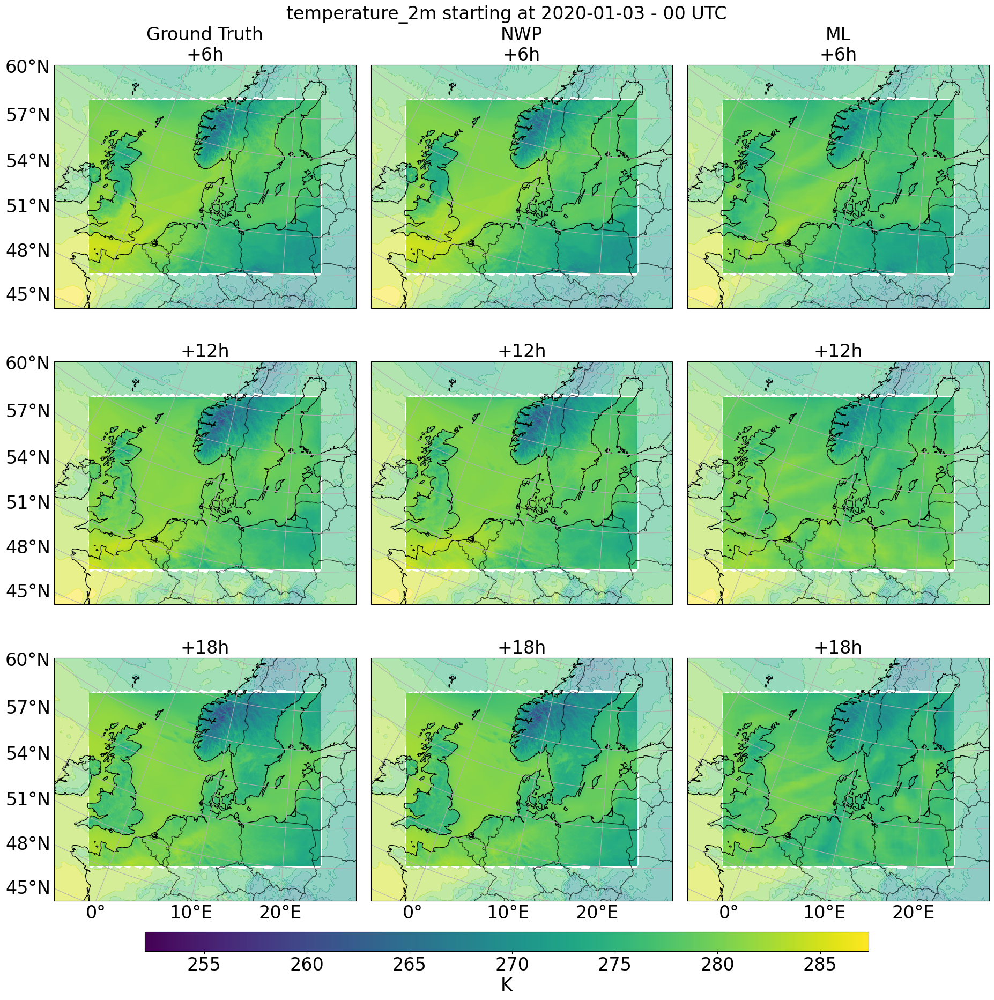

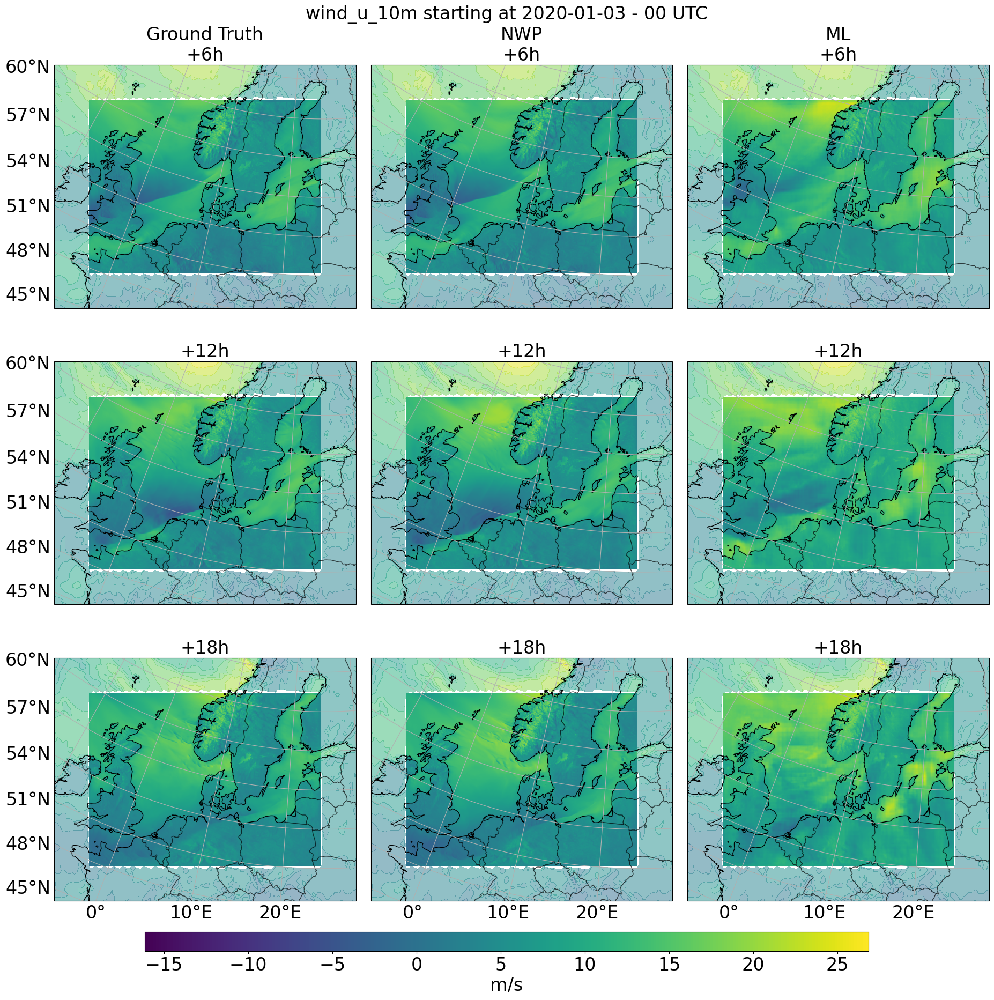

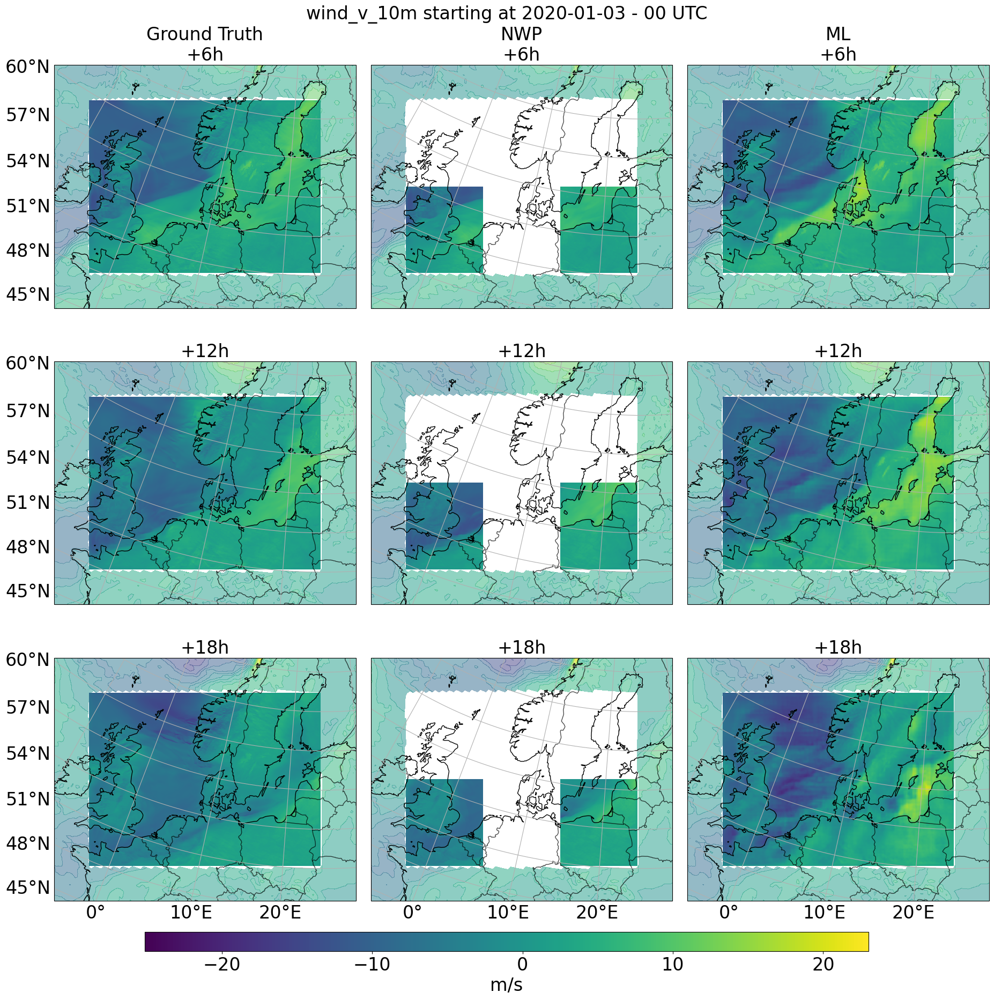

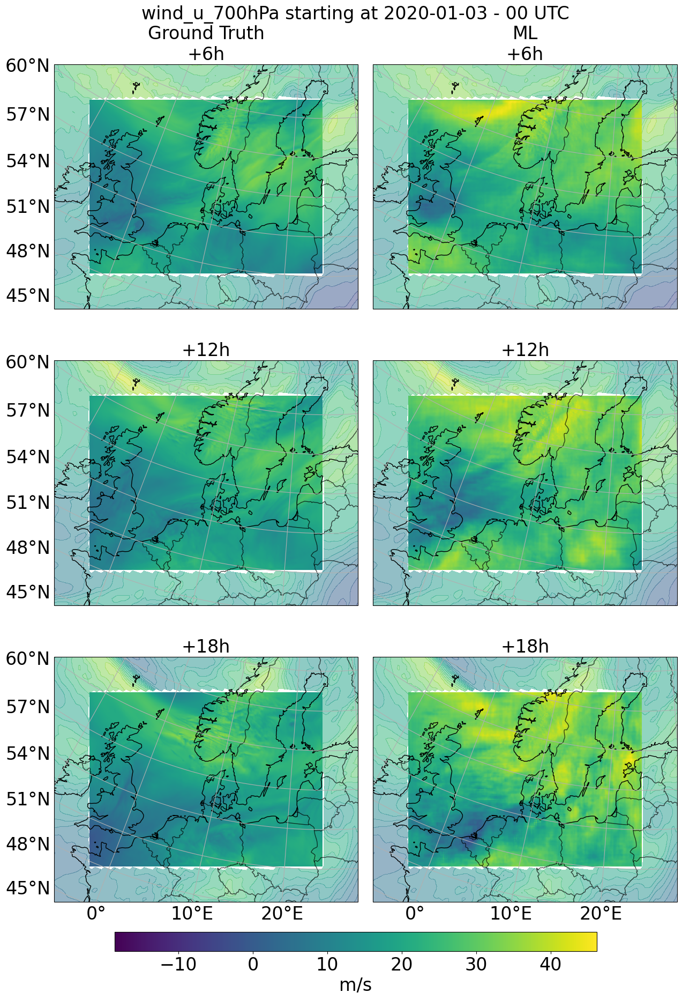

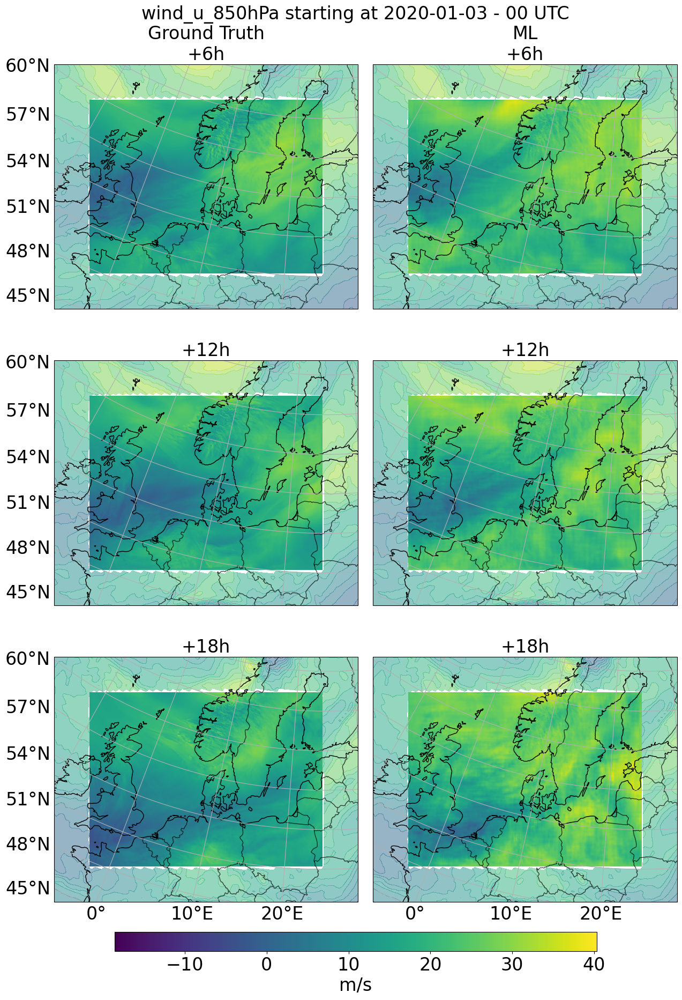

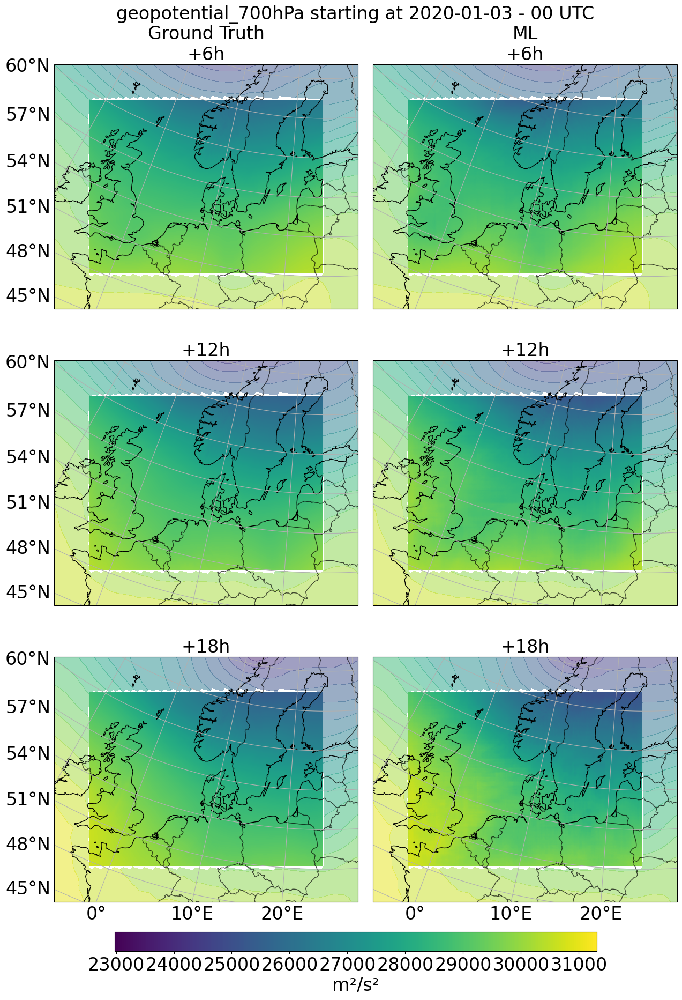

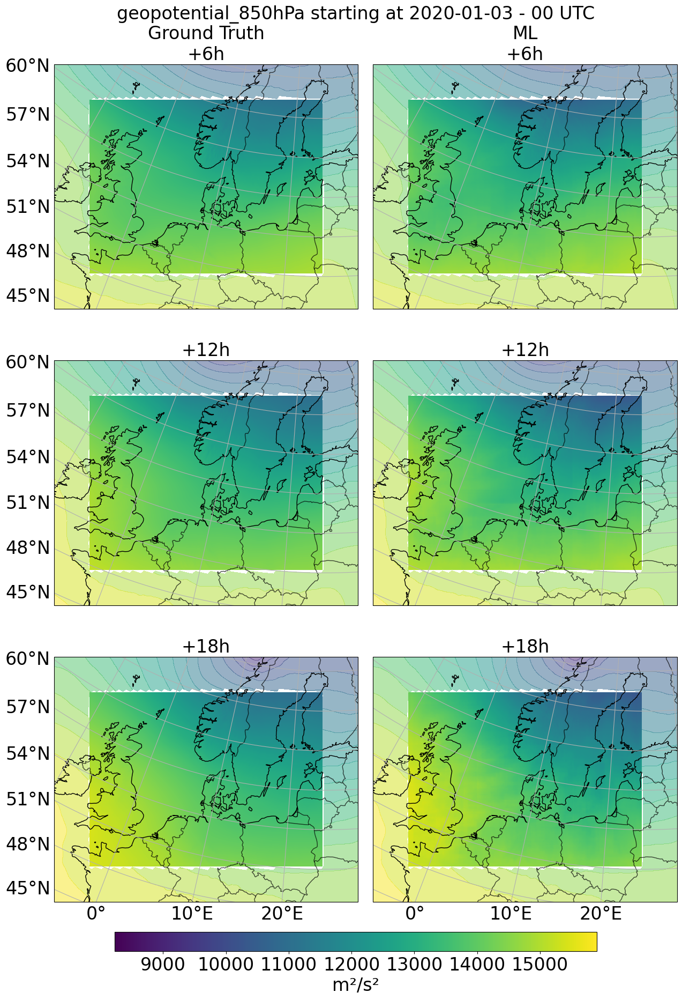

In [13]:
step_size_gt = pd.Timedelta(ds_gt.time.diff("time").min().values, "h")
ds_ml = ds_ml.assign_coords({
    "lon": (("x", "y"), ds_nwp.lon.values),
    "lat": (("x", "y"), ds_nwp.lat.values),
})
if PLOT_TIME is None:
    time_selected = None
else:
    time_selected = ds_ml.sel(start_time=PLOT_TIME).start_time
create_comparison_maps(
    ds_gt=ds_gt,
    ds_ml=ds_ml.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_PLOT),
    ds_nwp=ds_nwp.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_PLOT),
    ds_boundary=ds_boundary,
    plot_time=time_selected,
    step_size_gt=step_size_gt,
    zoom_factor=ZOOM,
)

#### Mean Error Plot Across All Start_Times

In [14]:
def create_error_maps(ds_gt, ds_ml, ds_nwp=None, var=None):
    """Create average error maps for model outputs organized in subfigures."""
    variables = [var] if var else VARIABLES_GROUND_TRUTH.values()

    n_elapsed_forecast_durations = len(ds_ml.elapsed_forecast_duration)

    for var in variables:
        n_cols = 2 if (ds_nwp is not None and var in ds_nwp) else 1

        fig = plt.figure(
            figsize=(13, 5 * n_elapsed_forecast_durations), dpi=DPI
        )

        axes = np.array([
            [
                plt.subplot(
                    n_elapsed_forecast_durations,
                    n_cols,
                    i * n_cols + j + 1,
                    projection=PROJECTION,
                )
                for j in range(n_cols)
            ]
            for i in range(n_elapsed_forecast_durations)
        ])

        arrays_for_minmax = []
        for dim_idx, elapsed_forecast_dimension in enumerate(
            ds_ml.elapsed_forecast_duration
        ):
            forecast_hours = int(elapsed_forecast_dimension.values / 1e9 / 3600)

            ds_ml_time = ds_ml.isel(
                start_time=0, elapsed_forecast_duration=dim_idx
            )
            lons = (
                ds_ml_time.longitude
                if hasattr(ds_ml_time, "longitude")
                else ds_ml_time.lon
            )
            lats = (
                ds_ml_time.latitude
                if hasattr(ds_ml_time, "latitude")
                else ds_ml_time.lat
            )

            # Calculate errors using mean_error function
            obs_times = ds_ml.forecast_time.sel(
                elapsed_forecast_duration=elapsed_forecast_dimension
            )

            errors = {}
            errors["ml"] = mean_error(
                ds_ml[var].sel(
                    elapsed_forecast_duration=elapsed_forecast_dimension
                ),
                ds_gt[var].sel(time=obs_times),
                preserve_dims=["x", "y"],
            )
            arrays_for_minmax.append(errors["ml"])

            if ds_nwp is not None and var in ds_nwp:
                errors["nwp"] = mean_error(
                    ds_nwp[var].sel(
                        elapsed_forecast_duration=elapsed_forecast_dimension
                    ),
                    ds_gt[var].sel(time=obs_times),
                    preserve_dims=["x", "y"],
                )
                arrays_for_minmax.append(errors["nwp"])

            # Calculate symmetric bounds
            abs_max = max(abs(np.nanmax(arr)) for arr in arrays_for_minmax)
            abs_max = max(
                abs_max, abs(min(np.nanmin(arr) for arr in arrays_for_minmax))
            )
            vmin, vmax = -abs_max, abs_max

            if ds_nwp is not None and var in ds_nwp:
                plot_error_field(
                    axes[dim_idx, 0], lons, lats, errors["nwp"], vmin, vmax
                )
                axes[dim_idx, 0].set_title(
                    f"Mean NWP Error\n+{forecast_hours}h"
                    if dim_idx == 0
                    else f"+{forecast_hours}h"
                )

            col_idx = 1 if ds_nwp is not None and var in ds_nwp else 0
            im = plot_error_field(
                axes[dim_idx, col_idx], lons, lats, errors["ml"], vmin, vmax
            )
            axes[dim_idx, col_idx].set_title(
                f"Mean ML Error\n+{forecast_hours}h"
                if dim_idx == 0
                else f"+{forecast_hours}h"
            )

        add_map_features(axes)
        add_error_colorbar(fig, im, var)

        plt.subplots_adjust(
            top=0.9,
            bottom=0.05,
            hspace=0.2,
            wspace=0.05,
        )

        title = f"Mean Error in {var}"
        plt.suptitle(title, y=0.98)

        plt.show()
        save_plot(fig, f"mean_errormap_{var}_multi_efd", dpi=DPI)
        plt.close()


def plot_error_field(ax, lons, lats, data, vmin, vmax):
    return ax.pcolormesh(
        lons,
        lats,
        data,
        transform=ccrs.PlateCarree(),
        cmap="RdBu_r",
        vmin=vmin,
        vmax=vmax,
        shading="auto",
        rasterized=True,
    )


def add_error_colorbar(fig, im, var):
    cbar_ax = fig.add_axes([0.2, 0.0, 0.6, 0.02])
    cbar = fig.colorbar(im, cax=cbar_ax, orientation="horizontal")
    cbar.set_label(f"Error in {VARIABLE_UNITS[var]}")


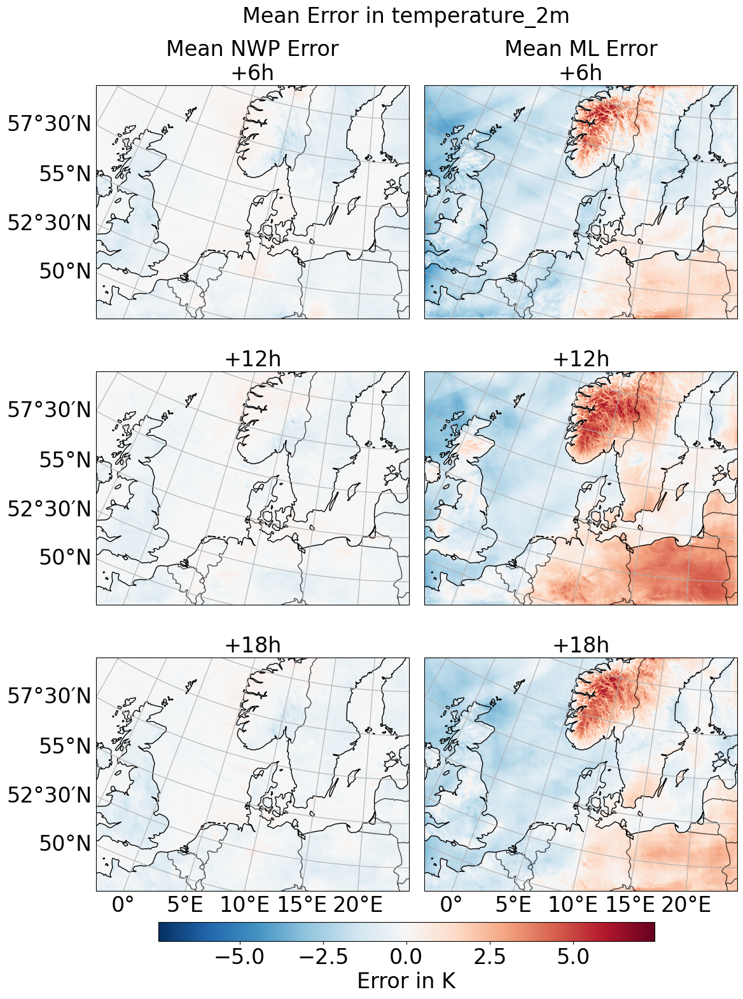

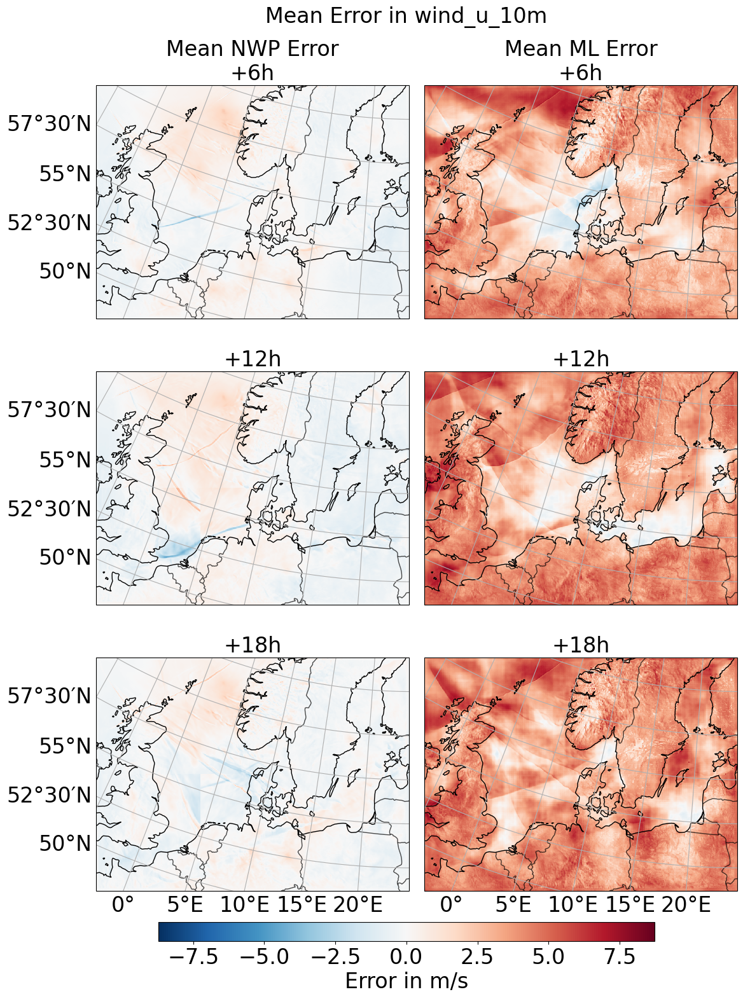

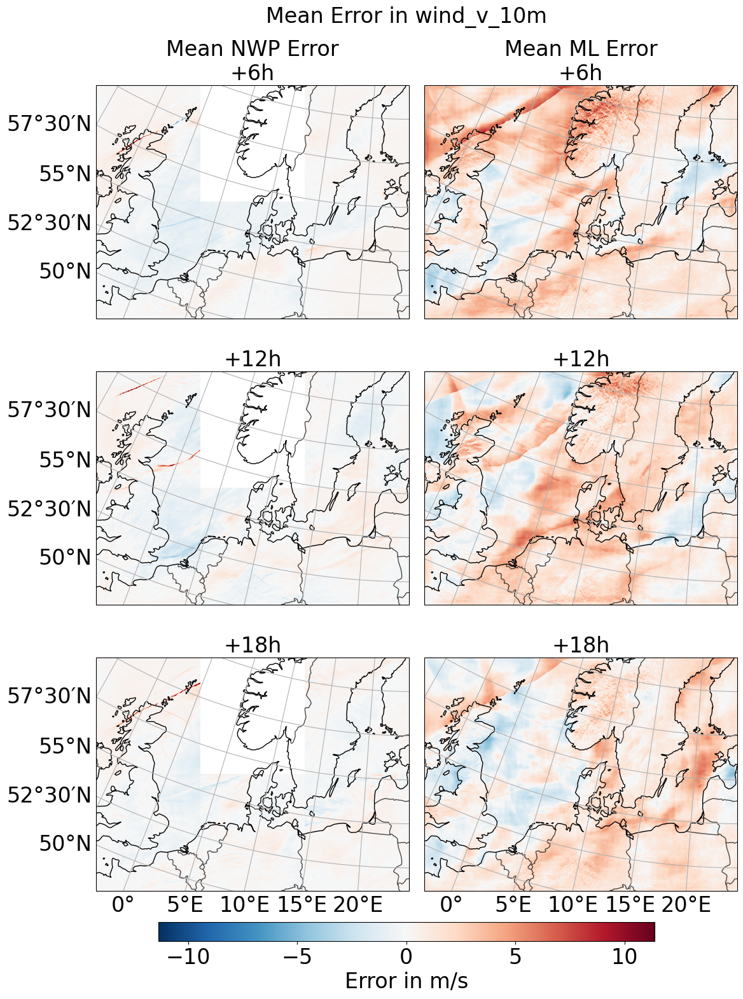

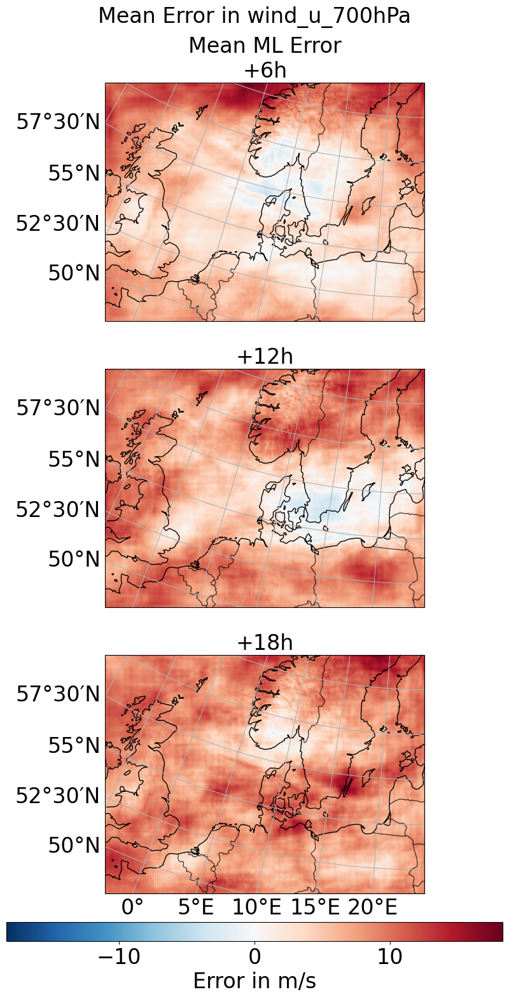

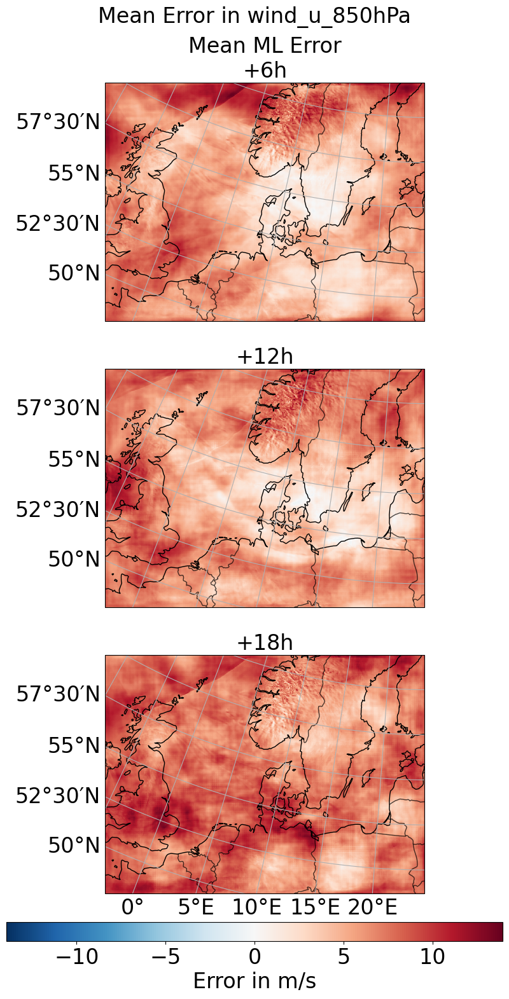

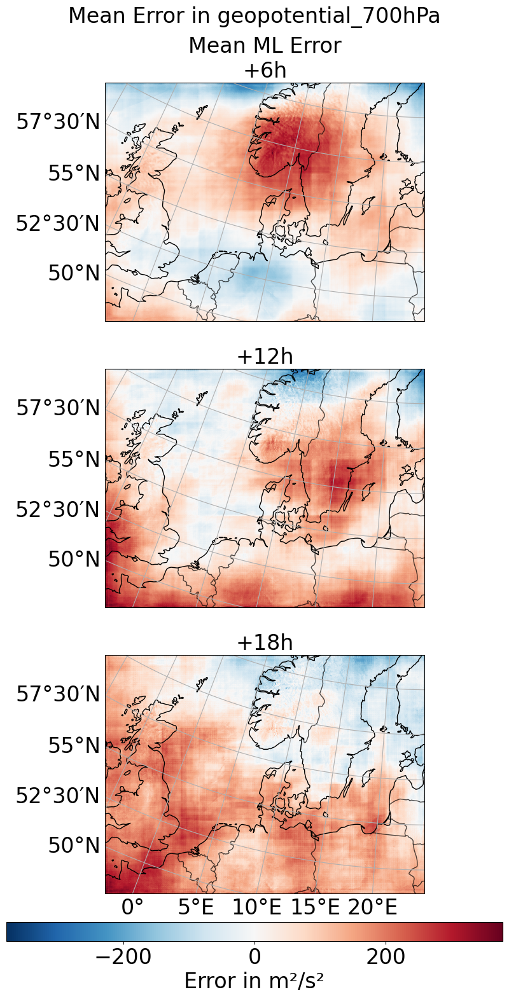

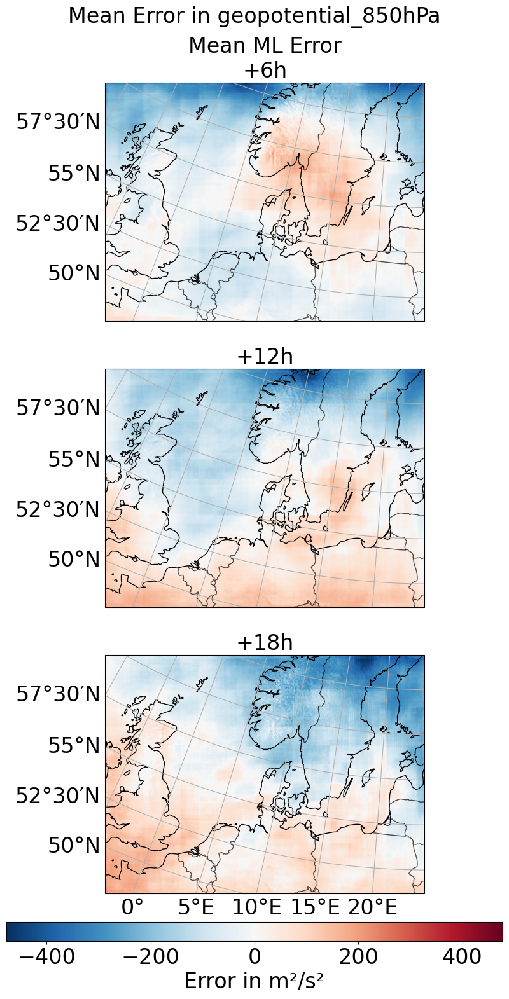

In [16]:
if "lon" not in ds_ml.coords:
    ds_ml = ds_ml.assign_coords({
        "lon": (("x", "y"), ds_nwp.lon.values),
        "lat": (("x", "y"), ds_nwp.lat.values),
    })
if PLOT_TIME is None:
    time_selected = None
else:
    time_selected = ds_ml.sel(start_time=PLOT_TIME).start_time
create_error_maps(
    ds_gt=ds_gt,
    ds_ml=ds_ml.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_PLOT),
    ds_nwp=ds_nwp.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_PLOT),
)

### 2. Vertical Profiles
In this chapter, the focus is on assessing how the relative error between the ML
model and ground truth data.
Vertical profiles are essential for understanding the atmospheric structure and
processes at different pressure levels. Obviously these plots only work for 3D
variables.

**Relative Error Calculation:** Using percentage differences provides a
normalized measure of error that is comparable across variables and vertical
levels.

**Altitude-Specific Insights:** The plots reveal whether the ML model performs
consistently across different altitudes or if certain layers pose challenges.

**Atmospheric Dynamics:** Accurate representation of vertical profiles is
crucial for modeling phenomena like convection or jet stream anomalies.

**Pressure Level Interpretation:** Lower vertical levels correspond to higher
altitudes. Inverted axes help represent this correctly but can be
counterintuitive.

Processing wind_u
Processing duration 3
Processing duration 6
Processing duration 9
Processing duration 12
Processing duration 15
Processing duration 18
Processing duration 21
Processing duration 24
Processing duration 27
Processing duration 30
Processing duration 33
Processing duration 36
Processing duration 39
Processing duration 42
Processing duration 45
Processing duration 48


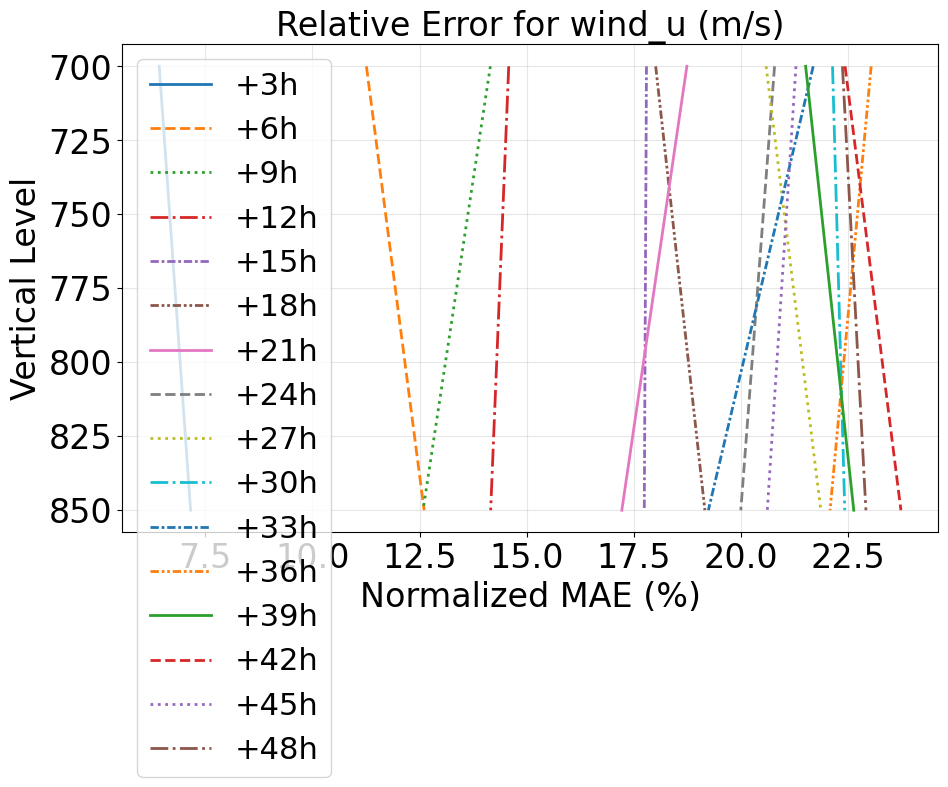

Processing geopotential
Processing duration 3
Processing duration 6
Processing duration 9
Processing duration 12
Processing duration 15
Processing duration 18
Processing duration 21
Processing duration 24
Processing duration 27
Processing duration 30
Processing duration 33
Processing duration 36
Processing duration 39
Processing duration 42
Processing duration 45
Processing duration 48


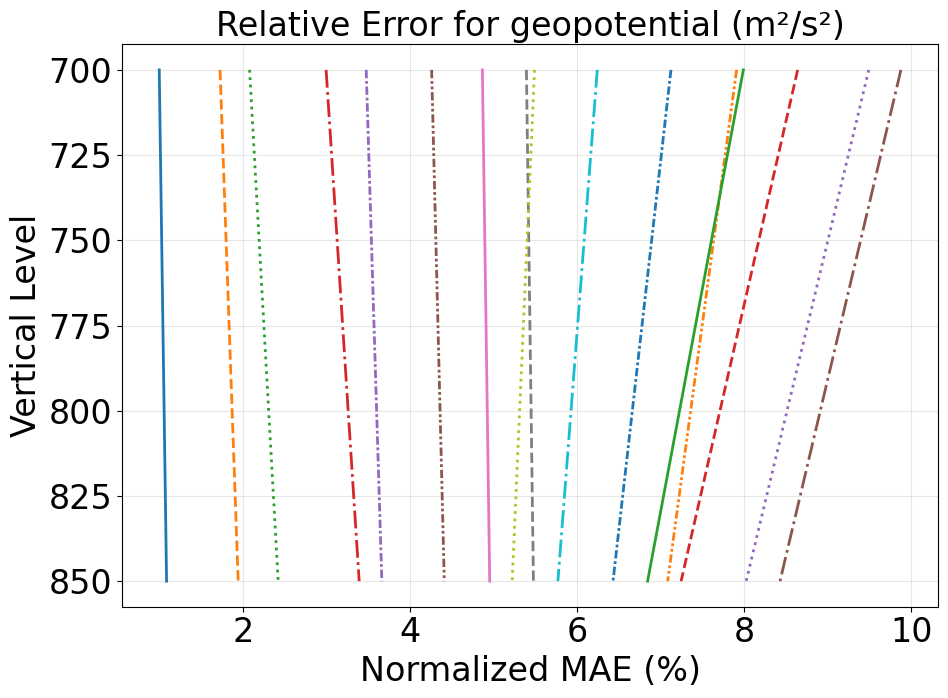

In [17]:
def plot_vertical_errors(ds_gt, ds_ml, variables):
    """
    Plot vertical profiles of relative error for each variable separately.
    Variables with same prefix are stacked along level dimension.
    Shows separate lines for each forecast duration.
    """
    LINESTYLES = [
        "-",
        "--",
        ":",
        "-.",
        (0, (3, 1, 1, 1)),
        (0, (3, 1, 1, 1, 1, 1)),
    ]

    # Group variables by their prefix (without level)
    var_groups = {}

    for var in variables.values():
        #if any(var.startswith(v) for v in VARIABLES_3D):
        if var.endswith("hPa"):
            base_name = "_".join(var.split("_")[:-1])
            level = int(var.split("_")[-1][:-3])

            if base_name not in var_groups:
                var_groups[base_name] = {"vars": [], "levels": []}
            var_groups[base_name]["vars"].append(var)
            var_groups[base_name]["levels"].append(level)
            var_groups[base_name]["unit"] = VARIABLE_UNITS[var]

    if len(var_groups) == 0:
        print("No 3D variables found in the dataset.")
        return

   # Plot each variable separately
    for base_name, group in var_groups.items():
        print("Processing", base_name)
        fig, ax = plt.subplots(figsize=(10, 7.5), dpi=DPI)

        # Sort by level
        sorted_idx = np.argsort(group["levels"])
        sorted_vars = [group["vars"][i] for i in sorted_idx]
        sorted_levels = [group["levels"][i] for i in sorted_idx]

        for dim_idx, elapsed_forecast_dimension in enumerate(
            ds_ml.elapsed_forecast_duration
        ):
            forecast_hours = int(elapsed_forecast_dimension.values / 1e9 / 3600)
            print("Processing duration", forecast_hours)

            # Get observation times for this forecast duration
            obs_times = ds_ml.forecast_time.sel(
                elapsed_forecast_duration=elapsed_forecast_dimension
            )

            # Stack variables for ground truth
            stacked_gt = xr.concat(
                [ds_gt[var].sel(time=obs_times) for var in sorted_vars],
                dim=pd.Index(sorted_levels, name="level"),
            )

            # Stack variables for ML predictions
            stacked_ml = xr.concat(
                [
                    ds_ml[var].sel(
                        elapsed_forecast_duration=elapsed_forecast_dimension
                    )
                    for var in sorted_vars
                ],
                dim=pd.Index(sorted_levels, name="level"),
            )

            # Calculate normalized MAE
            relative_error = (
                abs(stacked_ml - stacked_gt)
                / (
                    stacked_gt.max(dim=["start_time", "x", "y"]) 
                    - stacked_gt.min(dim=["start_time", "x", "y"])
                )
            ).mean(dim=["start_time", "x", "y"]) * 100

            # Plot with different linestyle for each duration
            ax.plot(
                relative_error,
                relative_error.level,
                linewidth=2,
                linestyle=LINESTYLES[dim_idx % len(LINESTYLES)],
                label=f"+{forecast_hours}h",
            )

        unit = group["unit"]
        ax.set_title(f"Relative Error for {base_name} ({unit})")
        ax.set_xlabel("Normalized MAE (%)")
        ax.set_ylabel("Vertical Level")
        ax.grid(True, alpha=0.3)
        ax.invert_yaxis()
        if base_name == list(var_groups.keys())[0]:
            ax.legend()

        plt.tight_layout()
        plt.show()
        save_plot(fig, f"vertical_profile_{base_name}")
        plt.close()

plot_vertical_errors(
    ds_gt,
    ds_ml_sampled,
    VARIABLES_GROUND_TRUTH,
)

### 3. Histograms
By examining these distributions, we can assess whether the ML model and NWP model accurately capture the variability and frequency of different atmospheric states.

**Distribution Shape:** The histograms show whether the models replicate the skewness, kurtosis, and overall shape of the ground truth data distributions.

**Extreme Values:** Identifying how the models handle extreme conditions, such as unusually high or low temperatures, is crucial for weather prediction and risk assessment.

**Normalization Needs:** Differences in scale between variables suggest that normalization may be necessary for accurate comparisons.

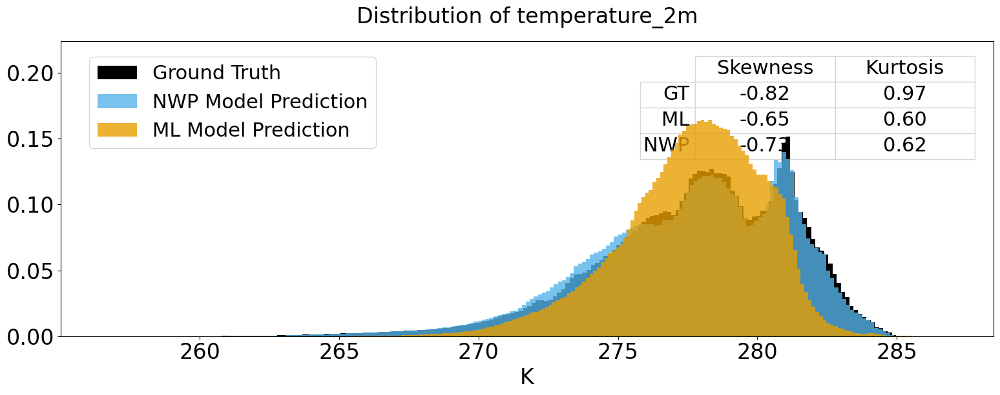

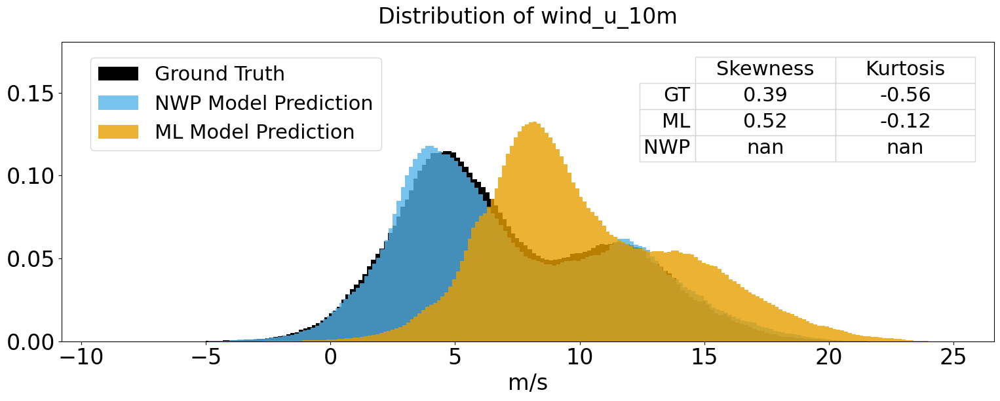

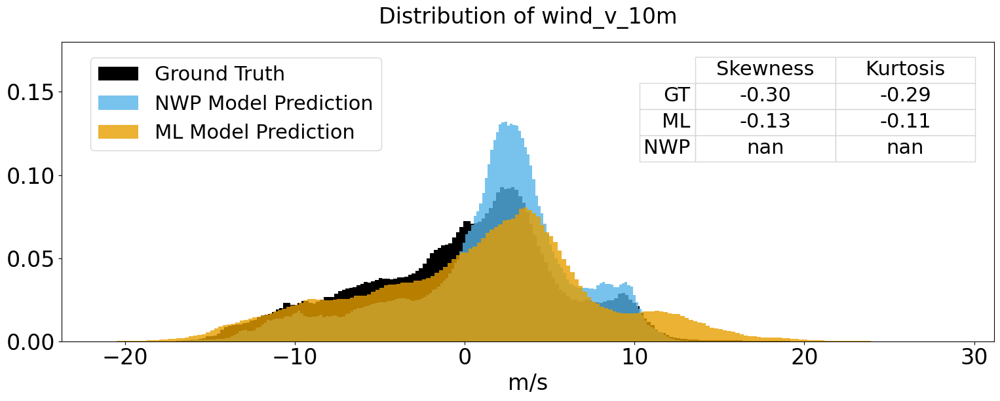

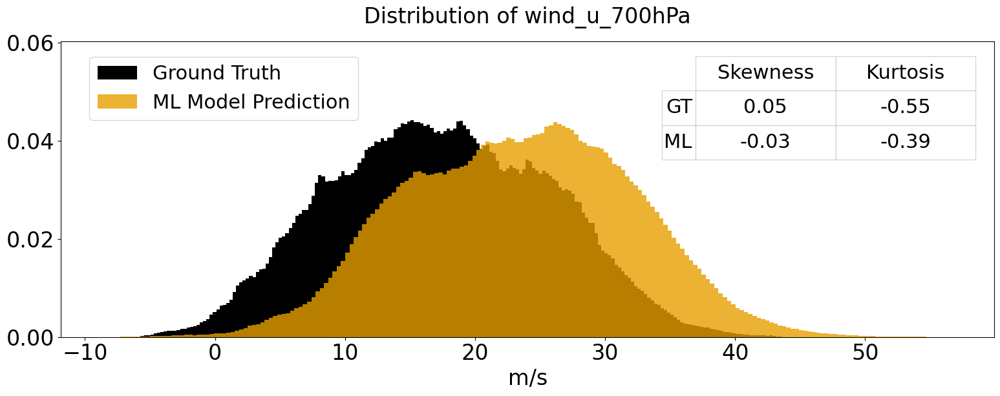

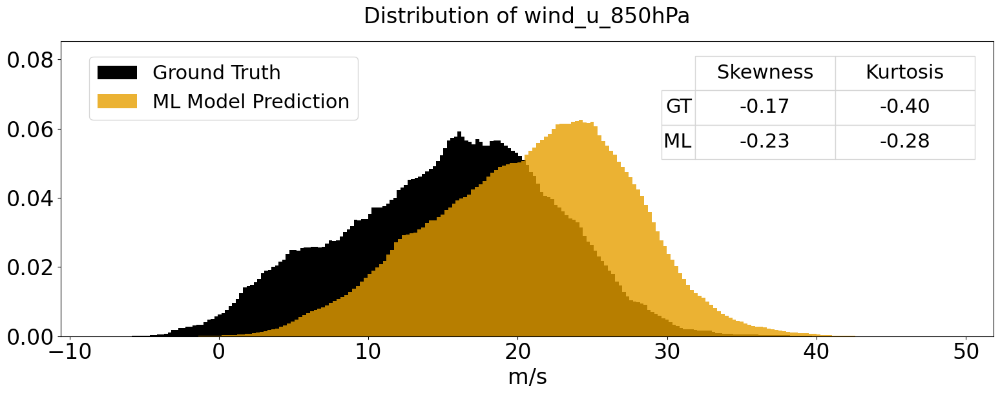

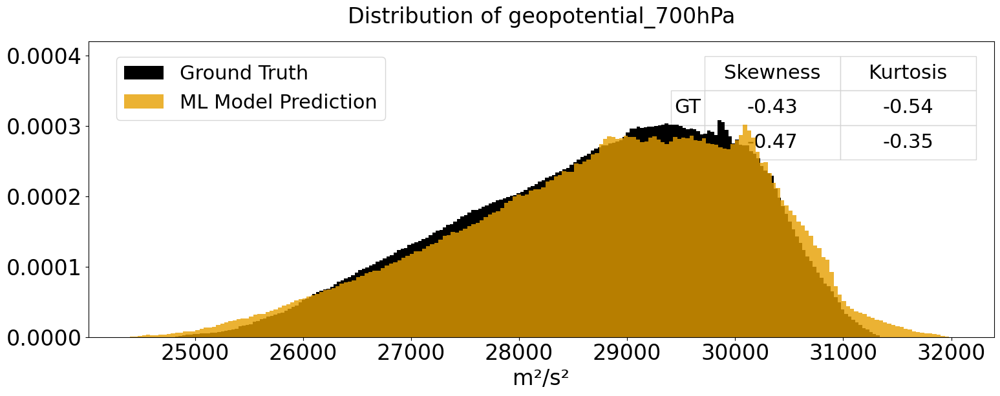

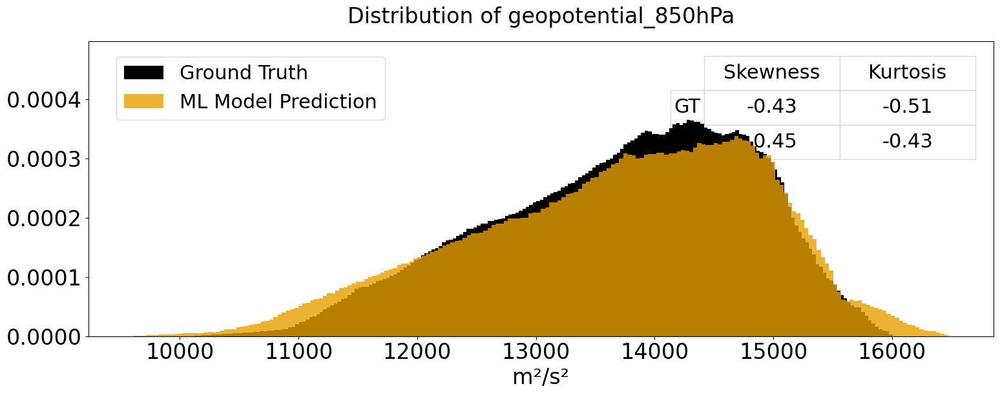

In [18]:
for variable_name in VARIABLES_GROUND_TRUTH.values():
    fig, ax = plt.subplots(figsize=(16, 7), dpi=DPI)

    # Convert to numpy arrays
    data_gt = ds_gt_sampled.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_SHORT)[variable_name].values.flatten()
    data_ml = ds_ml_sampled.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_SHORT)[variable_name].values.flatten()

    # Create histograms for ground truth
    ax.hist(
        data_gt,
        bins=200,
        density=True,
        color=COLORS["gt"],
        label="Ground Truth",
        histtype="stepfilled",  # Use filled steps without edges
        linewidth=0,
    )

    # Plot NWP if available
    if variable_name in ds_nwp:
        data_nwp = ds_nwp_sampled[variable_name].values.flatten()
        ax.hist(
            data_nwp,
            bins=200,
            alpha=0.8,
            density=True,
            color=COLORS["nwp"],
            label="NWP Model Prediction",
            histtype="stepfilled",
            linewidth=0,
        )

    # Create histogram for ML
    ax.hist(
        data_ml,
        bins=200,
        alpha=0.8,
        density=True,
        color=COLORS["ml"],
        label="ML Model Prediction",
        histtype="stepfilled",
        linewidth=0,
    )

    # Add labels and title with adjusted positioning
    units = VARIABLE_UNITS[variable_name]
    ax.set_title(
        f"Distribution of {variable_name}", pad=20
    )  # Add padding below title
    ax.set_xlabel(f"{units}")  # Add units to x-axis label

    # Place legend in top left with some padding from the edge
    ax.legend(loc="upper left", bbox_to_anchor=(0.02, 0.98))

    # Adjust axis limits to leave space for both legend and table
    current_ylim = ax.get_ylim()
    ax.set_ylim(0, current_ylim[1] * 1.3)  # Increased padding for both elements

    # Calculate statistics
    stats_data = {
        "GT": [f"{skew(data_gt):.2f}", f"{kurtosis(data_gt):.2f}"],
        "ML": [f"{skew(data_ml):.2f}", f"{kurtosis(data_ml):.2f}"],
    }
    if variable_name in ds_nwp:
        stats_data["NWP"] = [
            f"{skew(data_nwp):.2f}",
            f"{kurtosis(data_nwp):.2f}",
        ]

    # Create and position table in top right with adjusted dimensions
    col_labels = ["Skewness", "Kurtosis"]
    row_labels = list(stats_data.keys())
    cell_text = [[stats_data[row][i] for i in range(2)] for row in row_labels]

    table = ax.table(
        cellText=cell_text,
        rowLabels=row_labels,
        colLabels=col_labels,
        cellLoc="center",
        loc="upper right",
        bbox=[
            0.68,
            0.6,
            0.3,
            0.35,
        ],  # Adjust position (x, y, width, height)
    )

    # Enhanced table styling
    table.auto_set_font_size(False)
    table.set_fontsize(22)

    # Adjust column widths and row heights
    for (row, col), cell in table._cells.items():
        cell.set_text_props(wrap=True)
        cell.set_facecolor("white")
        cell.set_alpha(0.9)
        cell.set_edgecolor("#D3D3D3")  # Light gray color

        # Adjust column widths and alignment
        if col == -1:  # Row header column
            cell.set_text_props(horizontalalignment="right")  # Right align text
        else:  # Data columns
            cell.set_text_props(
                horizontalalignment="center"
            )  # Keep center alignment for data

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()
    save_plot(fig, f"histogram_{variable_name}")
    plt.close()


### 4. Energy Spectra

This chapter examines how energy is distributed across different spatial scales
in the atmosphere by computing and comparing the energy spectra of both models.
This analysis is critical in understanding the models' capabilities to simulate
atmospheric processes ranging from large-scale weather systems to small-scale
turbulence.

**FFT Computation:** The Fast Fourier Transform (FFT) is used to transform spatial data into the frequency domain, revealing how different scales contribute to the overall energy. The energy spectra are averaged over latitudes.

**Scale Representation:** The energy spectra show whether the ML model captures the correct amount of energy at various spatial scales.

**Effective Resolution:** Identifying the effective resolution helps understand the smallest scales that the model can reliably simulate.

**Numerical Artifacts:** Limitations in numerical precision can introduce artifacts in the spectra, especially at the smallest scales.

To interpret the Log-Spectral Distance (LSD) metric:
The LSD quantifies the difference between two spectra, with lower values indicating better similarity (area between the two spectra). 

Lower values indicate better similarity between spectra
- LSD = 0 means identical spectra

Typical values depend on the specific application, but generally:
- LSD < 1: Good similarity
- 1 < LSD < 2: Moderate differences
- LSD > 2: Significant differences

In [19]:
def calculate_energy_spectra(data):
    """Calculate the energy spectra of the given data using 2D FFT.

    Parameters
    ----------
    data : xarray.DataArray
        The data for which the energy spectra should be calculated.
        Expected dimensions must include 'x' and 'y', other dimensions will be handled automatically.

    Returns
    -------
    wavenumber : np.ndarray
        The isotropic wavenumbers.
    power : np.ndarray
        The power spectrum averaged over all non-spatial dimensions.
    effective_resolution : float
        The effective resolution of the model.
    """
    # Get grid spacing in meters
    dx = abs(float(data.x[1] - data.x[0]))
    dy = abs(float(data.y[1] - data.y[0]))

    # Identify spatial dimensions
    spatial_dims = ["y", "x"]

    # Move spatial dimensions to the end
    other_dims = [dim for dim in data.dims if dim not in spatial_dims]
    var_data = data.transpose(*other_dims, *spatial_dims).values

    # Reshape the array to combine all non-spatial dimensions
    shape = var_data.shape
    ny, nx = shape[-2:]

    if len(shape) > 2:
        var_data = var_data.reshape(-1, ny, nx)
    else:
        var_data = var_data[np.newaxis, :, :]

    # Compute 2D FFT
    fft_data = np.fft.fft2(var_data, axes=(-2, -1))
    power_spectrum = (np.abs(fft_data) ** 2).mean(axis=0)

    # Rest of the function remains the same
    # Get wavenumbers
    kx = np.fft.fftfreq(nx, d=dx)
    ky = np.fft.fftfreq(ny, d=dy)

    # Create 2D wavenumber grid
    kxx, kyy = np.meshgrid(kx, ky)
    k_mag = np.sqrt(kxx**2 + kyy**2)

    # Create wavenumber bins for azimuthal averaging
    k_bins = np.logspace(
        np.log10(k_mag[k_mag > 0].min()), np.log10(k_mag.max()), num=50
    )

    # Perform azimuthal averaging
    k_averaged = []
    power_averaged = []

    for i in range(len(k_bins) - 1):
        k_mask = (k_mag >= k_bins[i]) & (k_mag < k_bins[i + 1])
        if k_mask.any():
            k_averaged.append(np.mean(k_mag[k_mask]))
            power_averaged.append(np.mean(power_spectrum[k_mask]))

    # Convert to arrays
    k_averaged = np.array(k_averaged)
    power_averaged = np.array(power_averaged)

    # Calculate effective resolution
    effective_resolution = 1 / (4 * dx)

    # Remove first and last two wavenumbers
    return k_averaged[2:-2], power_averaged[2:-2], effective_resolution


def calculate_all_spectra(ds_gt, ds_ml, ds_nwp, variables):
    """Calculate and cache all energy spectra, including temporal evolution.

    Parameters
    ----------
    ds_gt : xarray.Dataset
        Ground truth dataset
    ds_ml : xarray.Dataset
        Machine learning model dataset
    ds_nwp : xarray.Dataset
        Numerical weather prediction model dataset
    variables : list
        List of variables to process

    Returns
    -------
    dict
        Nested dictionary containing wavenumbers, spectra and effective resolution
        for each dataset and variable, including temporal evolution
    """
    spectra_cache = {
        "gt": {},
        "ml": {"static": {}, "temporal": {}},
        "nwp": {"static": {}, "temporal": {}} if ds_nwp is not None else None,
    }

    for var in variables:
        if var not in ds_gt or var not in ds_ml:
            continue
        print(f"Calculating spectra for {var}...")

        # Calculate static spectra for ground truth
        k_gt, spec_gt, eff_res = calculate_energy_spectra(ds_gt[var])
        spectra_cache["gt"][var] = (k_gt, spec_gt, eff_res)

        # Calculate temporal spectra for ML model
        forecast_times = ds_ml.elapsed_forecast_duration.values
        ml_temporal = {}
        for time in forecast_times:
            data = ds_ml[var].sel(elapsed_forecast_duration=time)
            k, spec, _ = calculate_energy_spectra(data)
            ml_temporal[time] = (k, spec)

        spectra_cache["ml"]["temporal"][var] = ml_temporal
        spectra_cache["ml"]["static"][var] = calculate_energy_spectra(
            ds_ml[var]
        )

        # Calculate temporal spectra for NWP model if available
        if ds_nwp is not None and var in ds_nwp:
            forecast_times_nwp = ds_nwp.elapsed_forecast_duration.values
            nwp_temporal = {}
            for time in forecast_times_nwp:
                data = ds_nwp[var].sel(elapsed_forecast_duration=time)
                k, spec, _ = calculate_energy_spectra(data)
                nwp_temporal[time] = (k, spec)

            spectra_cache["nwp"]["temporal"][var] = nwp_temporal
            spectra_cache["nwp"]["static"][var] = calculate_energy_spectra(
                ds_nwp[var]
            )

    return spectra_cache


def plot_energy_spectra(spectra_cache, var, level=None, show_legend=False):
    """Plot energy spectra comparison using pre-calculated spectra.

    Parameters
    ----------
    spectra_cache : dict
        Cache containing pre-calculated spectra
    var : str
        Variable name to plot
    level : float, optional
        Vertical level in hPa
    show_legend : bool, optional
        Whether to show the legend (default: False)
    """
    k_gt, spec_gt, eff_res = spectra_cache["gt"][var]
    k_ml, spec_ml, _ = spectra_cache["ml"]["static"][var]

    fig, ax = plt.subplots(figsize=(11, 6.5), dpi=DPI)

    # Plot ground truth spectrum
    ax.loglog(
        k_gt,
        spec_gt,
        color=COLORS["gt"],
        label="Ground Truth",
        linestyle=LINE_STYLES["gt"][0],
        marker=LINE_STYLES["gt"][1],
        markevery=5,
    )

    # Plot NWP spectrum if available
    if spectra_cache["nwp"] and var in spectra_cache["nwp"]["static"]:
        k_nwp, spec_nwp, _ = spectra_cache["nwp"]["static"][var]
        ax.loglog(
            k_nwp,
            spec_nwp,
            color=COLORS["nwp"],
            label="NWP Model Prediction",
            linestyle=LINE_STYLES["nwp"][0],
            marker=LINE_STYLES["nwp"][1],
            markevery=3,
        )

    # Plot ML spectrum
    ax.loglog(
        k_ml,
        spec_ml,
        color=COLORS["ml"],
        label="ML Model Prediction",
        linestyle=LINE_STYLES["ml"][0],
        marker=LINE_STYLES["ml"][1],
        markevery=4,
    )

    # Plot effective resolution
    ax.axvline(
        eff_res,
        color="salmon",
        linestyle="--",
        label="Effective Model Resolution",
    )

    # Add LSD metric
    spec_nwp = (
        spectra_cache["nwp"]["static"][var][1]
        if spectra_cache["nwp"] and var in spectra_cache["nwp"]["static"]
        else None
    )
    add_lsd_to_plot(ax, spec_gt, spec_ml, spec_nwp)

    # Customize plot
    ax.set_xlabel("Wavenumber (1/m)")
    unit = VARIABLE_UNITS.get(var, "")
    ax.set_ylabel(f"Energy Density (({unit})² * m)")
    title = f"Energy Spectra Comparison for {var}"
    if level is not None:
        title += f" at Level {level} hPa"
    ax.set_title(title)
    if show_legend:
        ax.legend(loc='upper right')
    ax.grid(True, which="both", ls="--", alpha=0.5)

    # Save and display plot
    plot_name = f"energy_spectra_{var}"
    if level is not None:
        plot_name += f"_level_{level}"
    plt.tight_layout()
    plt.show()
    save_plot(fig, plot_name)
    plt.close()


def display_lsd_table(spectra_cache, variables, name, caption=""):
    """Display and export LSD metrics table using pre-calculated spectra.

    Parameters
    ----------
    spectra_cache : dict
        Cache containing pre-calculated spectra
    variables : list
        List of variables to analyze
    name : str
        Name for exported files
    caption : str, optional
        Caption for LaTeX table
    """
    lsd_data = {var: {"ML": None, "NWP": None} for var in variables}

    for var in variables:
        if (
            var not in spectra_cache["gt"]
            or var not in spectra_cache["ml"]["static"]
        ):
            continue

        spec_gt = spectra_cache["gt"][var][1]
        spec_ml = spectra_cache["ml"]["static"][var][1]
        spec_nwp = (
            spectra_cache["nwp"]["static"][var][1]
            if spectra_cache["nwp"] and var in spectra_cache["nwp"]["static"]
            else None
        )

        lsd_ml, lsd_nwp = calculate_log_spectral_distance(
            spec_gt, spec_ml, spec_nwp
        )
        lsd_data[var]["ML"] = lsd_ml
        if lsd_nwp is not None:
            lsd_data[var]["NWP"] = lsd_nwp

    df = pd.DataFrame(lsd_data).T

    # Display styled table
    styled_df = df.style.format(
        lambda x: f"{x:.3f}" if pd.notnull(x) else "-"
    ).map(
        lambda x: f"color: {'green' if x < 1 else 'orange' if x < 2 else 'red'}"
        if pd.notnull(x)
        else ""
    )
    display(styled_df)

    # Export raw dataframe
    export_table(df, name, caption)


def plot_wavenumber_evolution(
    spectra_cache,
    ds_ml,
    ds_nwp,
    variables,
    wavenumbers=[1e-2, 5e-2, 1e-1],
    level=None,
):
    """Plot wavenumber evolution using pre-calculated temporal spectra.

    Parameters
    ----------
    spectra_cache : dict
        Cache containing pre-calculated spectra including temporal evolution
    ds_ml : xarray.Dataset
        Machine learning model dataset (used only for time coordinates)
    ds_nwp : xarray.Dataset
        Numerical weather prediction model dataset
    variables : list
        List of variables to analyze
    wavenumbers : list, optional
        List of wavenumbers to analyze
    level : float, optional
        Vertical level in hPa
    """
    forecast_times = ds_ml.elapsed_forecast_duration.values

    for var in variables:
        if (
            var not in spectra_cache["gt"]
            or var not in spectra_cache["ml"]["temporal"]
        ):
            continue

        fig, axes = plt.subplots(1, len(wavenumbers), figsize=(24, 8), dpi=DPI)

        for idx, target_k in enumerate(wavenumbers):
            spectra = {
                "gt": [],
                "ml": [],
                "nwp": [] if spectra_cache["nwp"] else None,
            }

            # Get ground truth power for target wavenumber
            k_gt, spec_gt, _ = spectra_cache["gt"][var]
            idx_k_gt = np.abs(k_gt - target_k).argmin()
            gt_power = spec_gt[idx_k_gt]

            for time in forecast_times:
                # Get ML spectra from cache
                k_ml, spec_ml = spectra_cache["ml"]["temporal"][var][time]
                idx_k_ml = np.abs(k_ml - target_k).argmin()
                spectra["ml"].append(spec_ml[idx_k_ml])

                # Get NWP spectra from cache if available
                if (
                    spectra_cache["nwp"]
                    and var in spectra_cache["nwp"]["temporal"]
                    and time in spectra_cache["nwp"]["temporal"][var]
                ):
                    k_nwp, spec_nwp = spectra_cache["nwp"]["temporal"][var][
                        time
                    ]
                    idx_k_nwp = np.abs(k_nwp - target_k).argmin()
                    spectra["nwp"].append(spec_nwp[idx_k_nwp])
                else:
                    spectra["nwp"].append(np.nan)


                spectra["gt"].append(gt_power)

            # Plot evolution for current wavenumber
            hours = forecast_times / np.timedelta64(1, "h")

            # Export table
            export_table(
                pd.DataFrame(
                    {
                        key.upper(): values
                        for key, values in spectra.items()
                        if values
                    },
                    index=hours,
                ).rename_axis(
                    index="Elapsed Forecast Duration (h)",
                    columns=f"Energy Density (k={target_k:.2e})",
                ),
                f"wavenumber_evolution_{var}_k{target_k:.2e}",
            )

            # Plot spectra
            for key, values in spectra.items():
                if not values:
                    continue
                
                if not np.isnan(values).all():
                    axes[idx].plot(
                        hours,
                        values,
                        color=COLORS[key],
                        linestyle=LINE_STYLES[key][0],
                        marker=LINE_STYLES[key][1],
                        label=key.upper(),
                    )

            # Add titles and labels
            axes[idx].set_title(f"k = {target_k:.2f}")
            if idx == len(wavenumbers) // 2:  # Only middle plot gets x-label
                axes[idx].set_xlabel("Elapsed Forecast Duration (h)")
            if idx == 0:
                axes[idx].set_ylabel("Energy Density")
                axes[idx].legend()

        plt.tight_layout()
        plt.show()
        save_plot(fig, f"wavenumber_evolution_{var}", remove_title=False)


def calculate_log_spectral_distance(true_spectrum, ml_spectrum, nwp_spectrum):
    """
    Calculate the Log Spectral Distance between three power spectra
    """
    eps = 1e-10
    log_spec1 = np.log10(true_spectrum + eps)
    log_spec2 = np.log10(ml_spectrum + eps)
    lsd_ml = np.sqrt(np.mean((log_spec1 - log_spec2) ** 2))
    if nwp_spectrum is None:
        return lsd_ml, None
    log_spec3 = np.log10(nwp_spectrum + eps)
    lsd_nwp = np.sqrt(np.mean((log_spec1 - log_spec3) ** 2))
    return lsd_ml, lsd_nwp


def add_lsd_to_plot(ax, true_spectrum, ml_spectrum, nwp_spectrum):
    """
    Add LSD metric as text box to spectrum plot
    """
    if nwp_spectrum is None:
        lsd_nwp = None
        lsd_ml, _ = calculate_log_spectral_distance(
            true_spectrum, ml_spectrum, None
        )
        textstr = f"LSD ML = {lsd_ml:.4f}"
    else:
        lsd_ml, lsd_nwp = calculate_log_spectral_distance(
            true_spectrum, ml_spectrum, nwp_spectrum
        )
        textstr = f"LSD NWP = {lsd_nwp:.4f}, LSD ML = {lsd_ml:.4f}"
    props = dict(boxstyle="round", facecolor="wheat", alpha=0.5)
    ax.text(
        0.05,
        0.1,
        textstr,
        transform=ax.transAxes,
        verticalalignment="top",
        bbox=props,
    )

In [20]:
# Calculate all spectra once and cache them
spectra_cache_short = calculate_all_spectra(
    ds_gt_sampled, 
    ds_ml_sampled.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_SHORT), 
    ds_nwp_sampled.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_SHORT), 
    VARIABLES_GROUND_TRUTH.values()
)

Calculating spectra for temperature_2m...
Calculating spectra for wind_u_10m...
Calculating spectra for wind_v_10m...
Calculating spectra for wind_u_700hPa...
Calculating spectra for wind_u_850hPa...
Calculating spectra for geopotential_700hPa...
Calculating spectra for geopotential_850hPa...


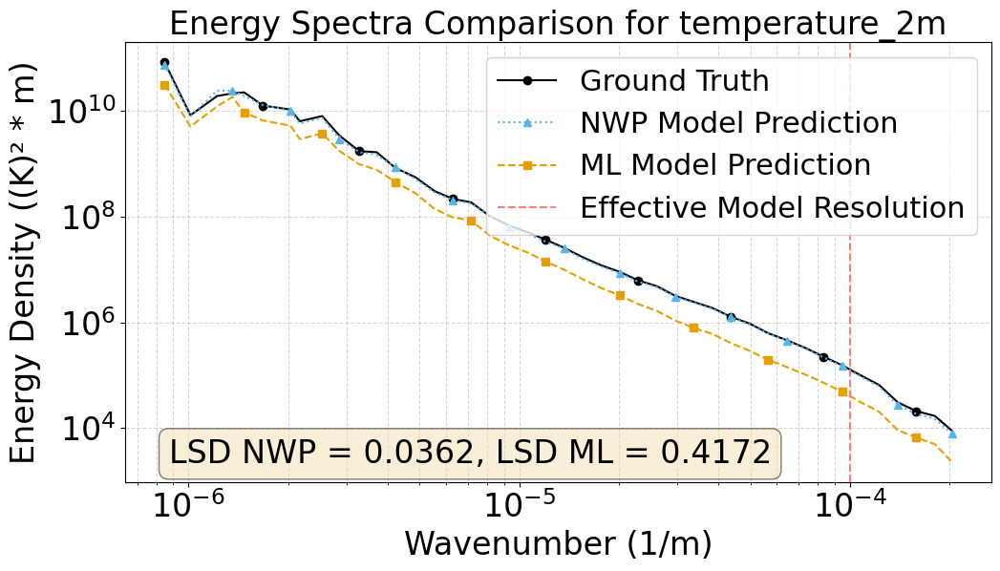

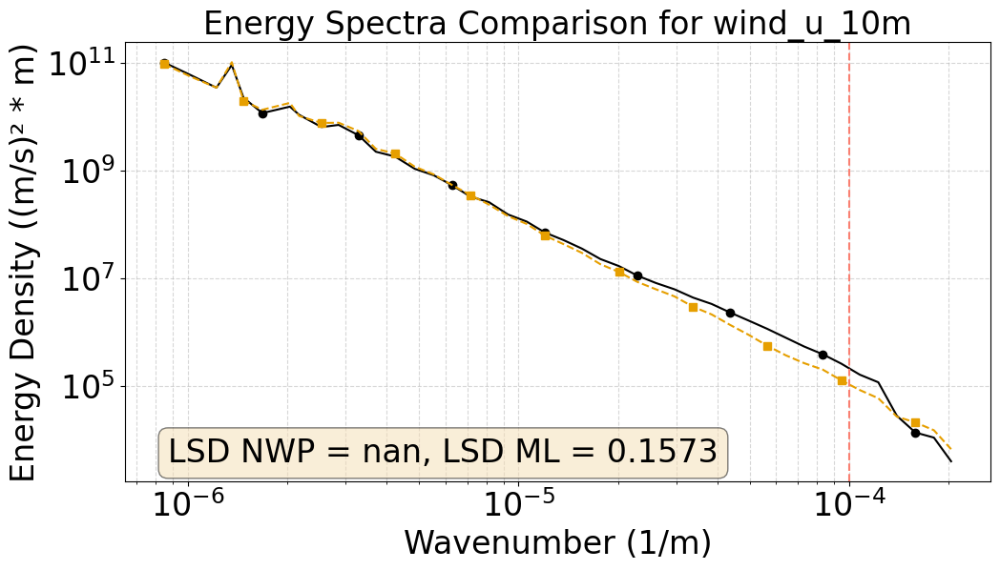

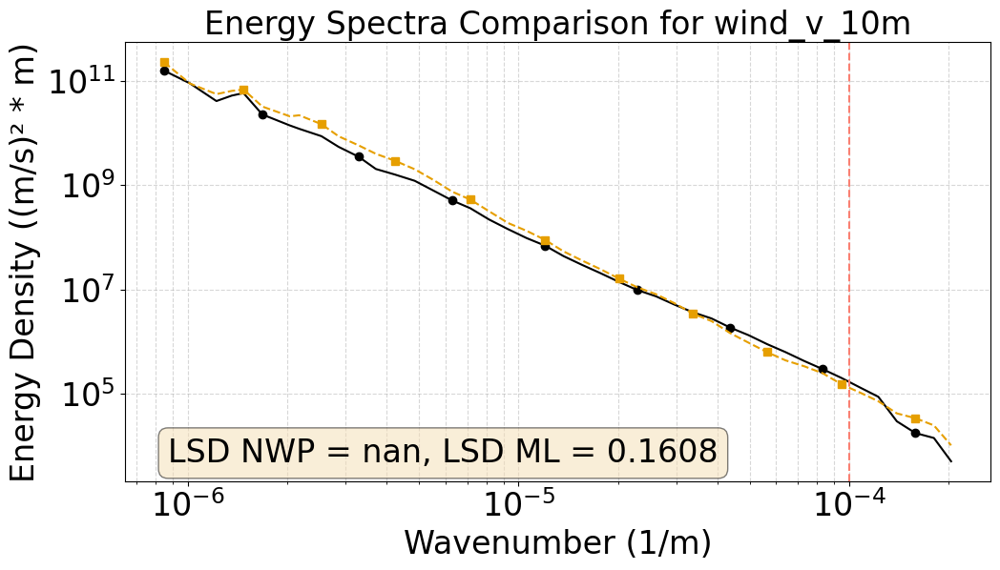

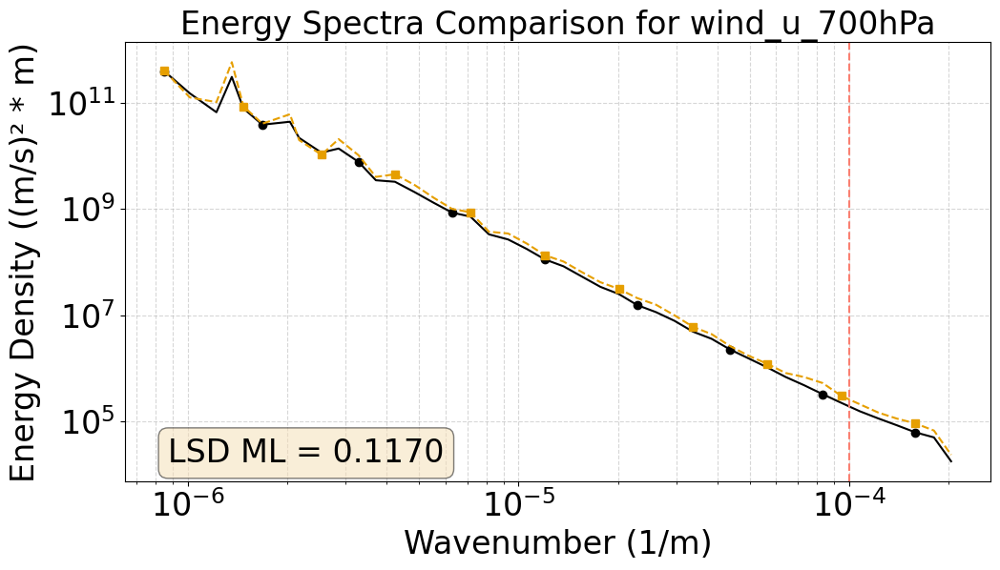

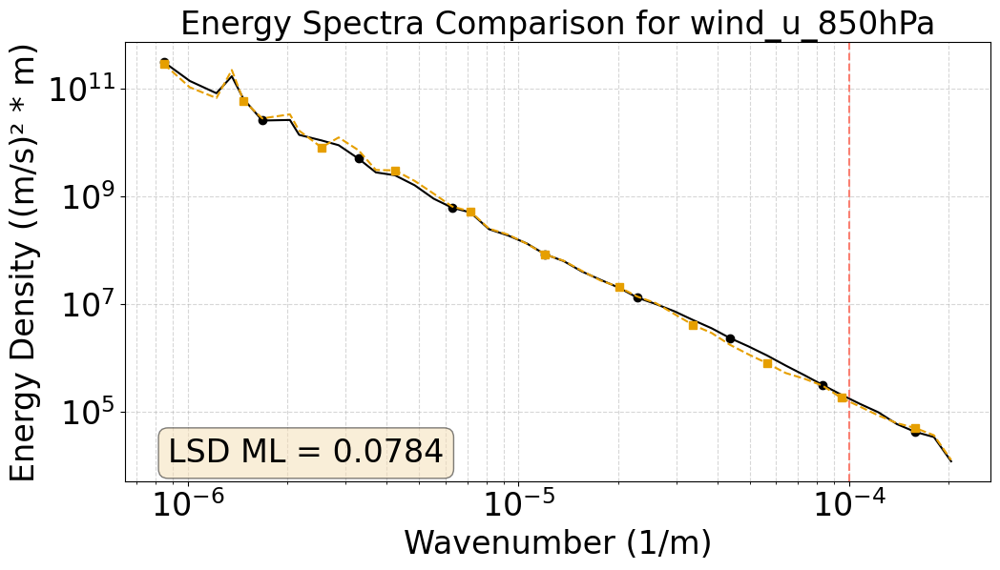

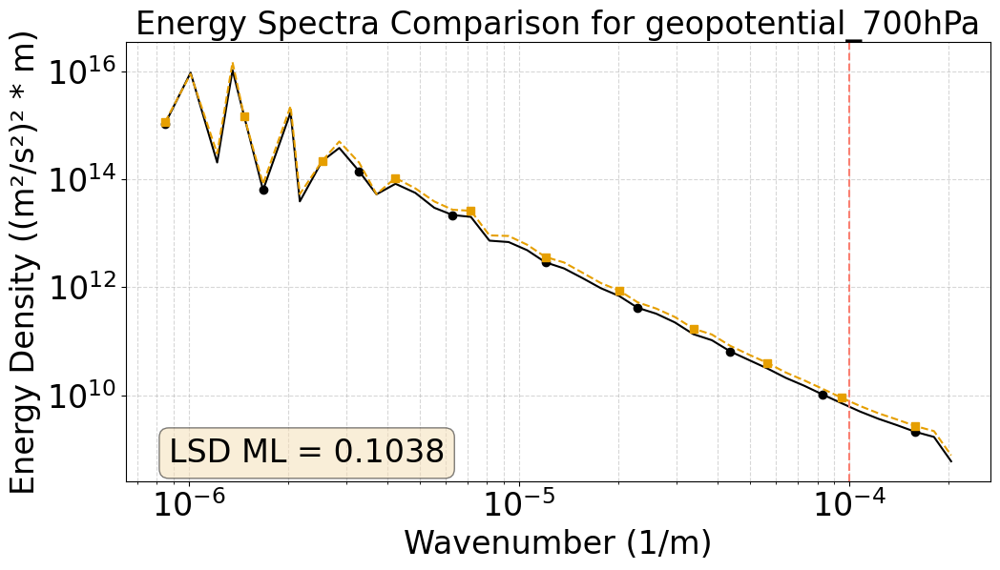

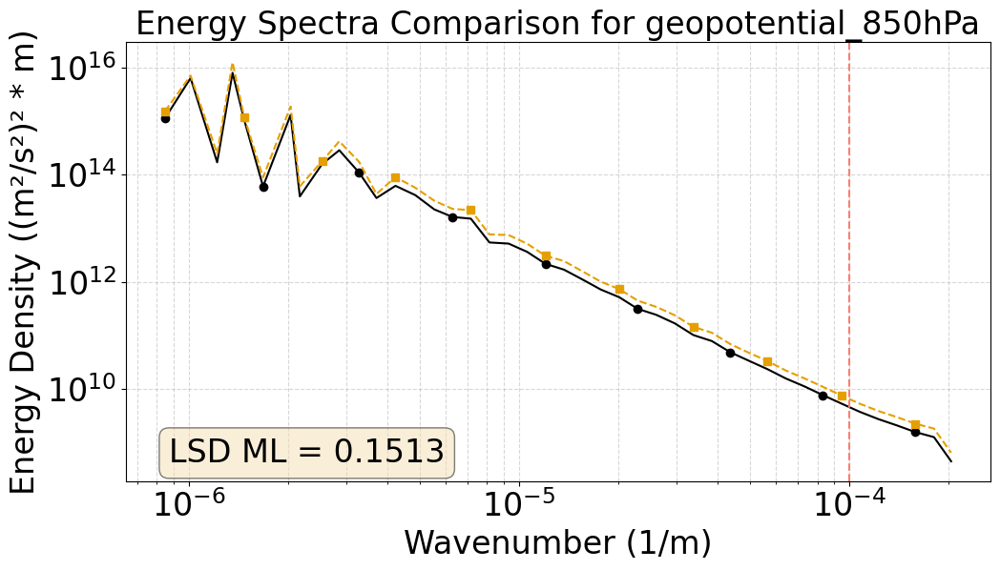

In [21]:
# Plot energy spectra for all variables
for i, var in enumerate(VARIABLES_GROUND_TRUTH.values()):
    plot_energy_spectra(spectra_cache_short, var, show_legend=(i == 0))

In [22]:
# Display and export LSD metrics table
display_lsd_table(
    spectra_cache_short,
    VARIABLES_GROUND_TRUTH.values(),
    name="lsd_metrics",
    caption="Log Spectral Distance (LSD) metrics comparison between ML and NWP models",
)


,ML,NWP
temperature_2m,0.417,0.036
wind_u_10m,0.157,-
wind_v_10m,0.161,-
wind_u_700hPa,0.117,-
wind_u_850hPa,0.078,-
geopotential_700hPa,0.104,-
geopotential_850hPa,0.151,-


In [23]:
# Re-compute to get all lead times for ML model
spectra_cache = calculate_all_spectra(
    ds_gt_sampled, 
    ds_ml_sampled,
    ds_nwp_sampled,
    VARIABLES_GROUND_TRUTH.values()
)

Calculating spectra for temperature_2m...
Calculating spectra for wind_u_10m...
Calculating spectra for wind_v_10m...
Calculating spectra for wind_u_700hPa...
Calculating spectra for wind_u_850hPa...
Calculating spectra for geopotential_700hPa...
Calculating spectra for geopotential_850hPa...


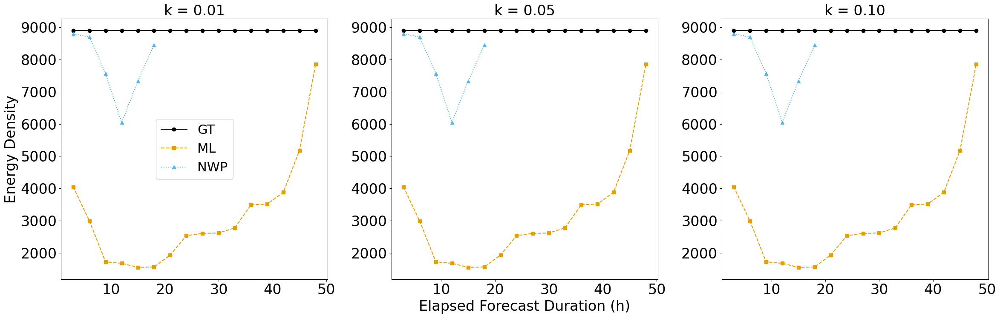

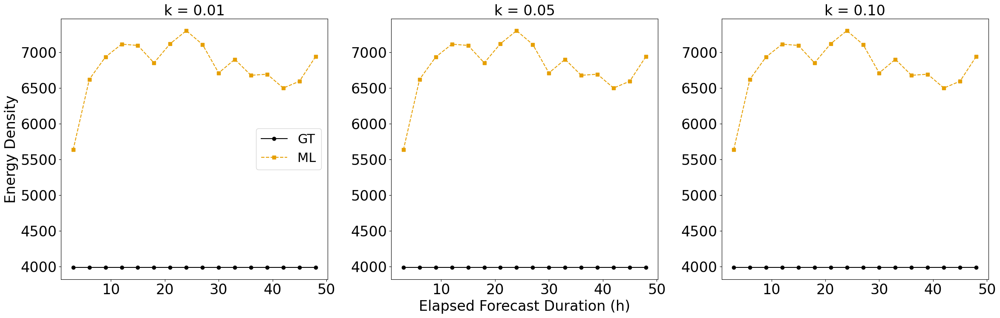

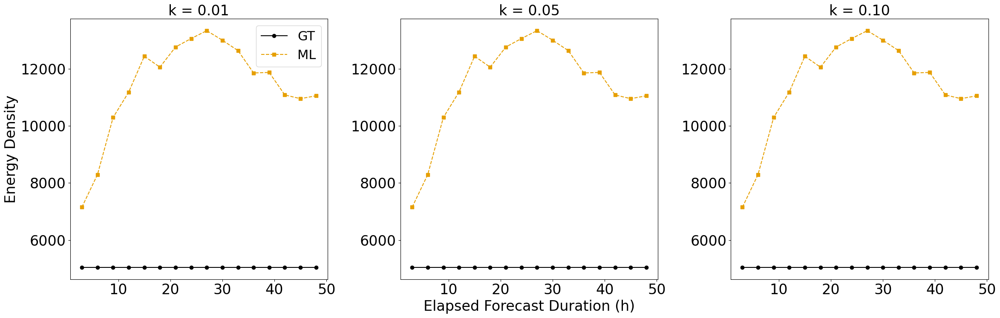

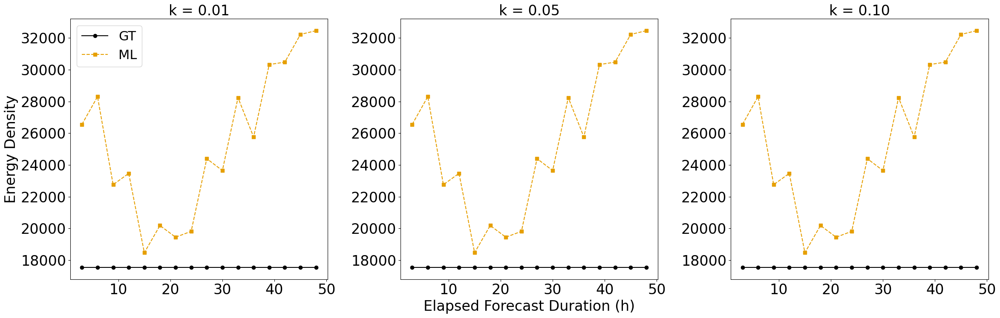

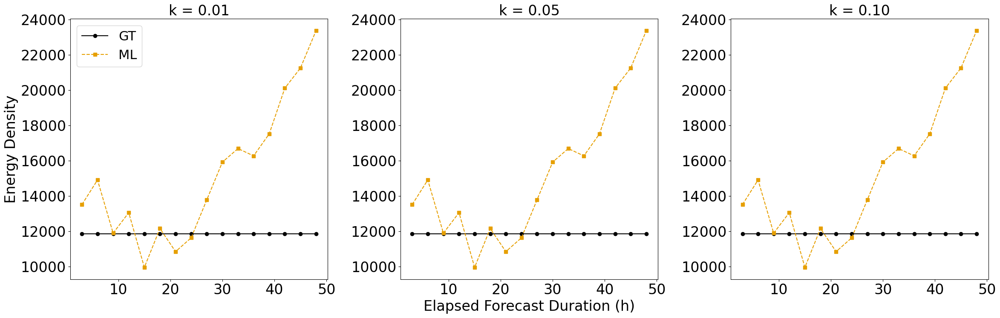

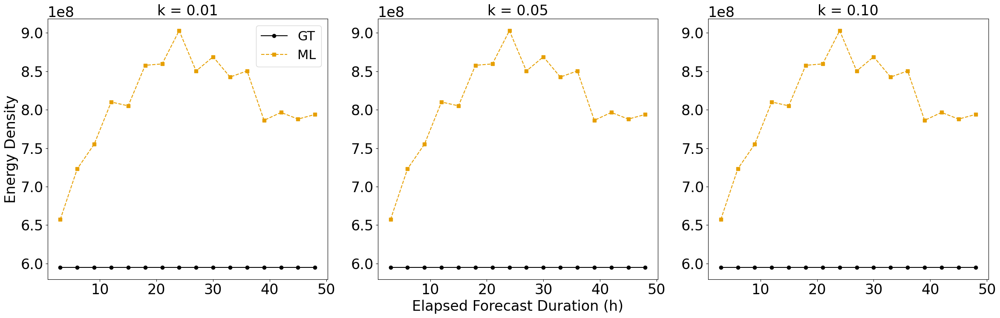

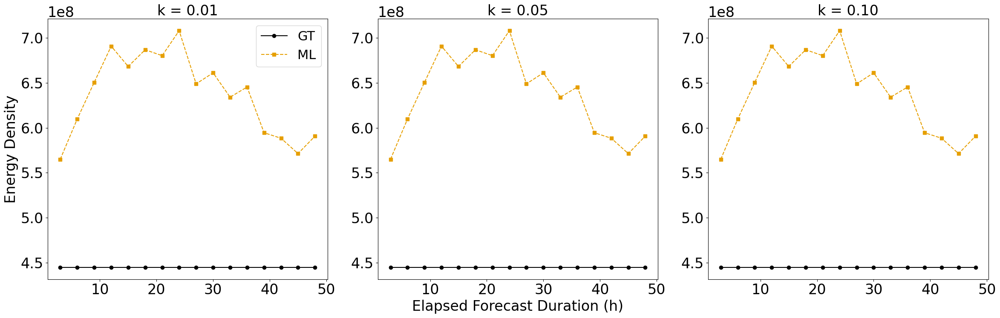

In [24]:
# Plot wavenumber evolution
plot_wavenumber_evolution(
    spectra_cache, ds_ml, ds_nwp, variables=VARIABLES_GROUND_TRUTH.values()
)


### 5. Various Verification Metrics
The final chapter consolidates various statistical metrics to provide a broad
evaluation of the ML model's performance. By considering multiple metrics, we
gain a nuanced understanding of both the strengths and weaknesses of the model.

**Metric Diversity:** Including MAE, RMSE, MSE, Pearson correlation, and the
Fractions Skill Score (FSS) covers different aspects of model performance, from
average errors to spatial pattern accuracy.

**ME** (Mean Error): Indicates the average discrepancy between the model and ground truth values. A positive value indicates that the model tends to overestimate, while a negative value suggests underestimation. Also called Bias.

**STDEV-ERR** (Standard Deviation of Errors): Shows the variability of errors, highlighting whether the model is consistent in its predictions.

**MAE, MSE and RMSE:** Offer insights into the average magnitude of errors, with
RMSE emphasizing larger discrepancies. The colors indicating high errors are
only implemented for these three metrics with standardization.

**Pearson Correlation:** Assesses the linear relationship, indicating whether
the model captures variability even if biases exist.

**FSS:** Evaluates spatial accuracy, which is particularly important for
predicting localized weather events.

**Wasserstein Distance:** Provides a holistic view of distributional similarity
across variables. Same as chapter 3.

**Holistic Assessment:** The combination of metrics provides a comprehensive
performance profile, essential for model validation and comparison. More complex metrics are explained in more detail.

#### Fractions Skill Score
Range: 0 to 1, where:
- 1 = perfect score
- 0 = no skill compared to random chance

**Key Properties:**
- FSS measures the spatial agreement between two fields, accounting for the spatial scale of the features
- It's particularly useful for assessing the spatial distribution of precipitation, cloud cover, or other fields with spatial structure
- FSS is sensitive to the threshold used to define the presence of a feature, so it's important to choose an appropriate threshold
- The FSS can be calculated for different spatial scales by defining the window size

**Advantages:**
- More meaningful than simple correlation for spatial fields
- Accounts for the spatial scale of features
- Provides a single value for the entire field comparison

In [25]:
# These helper functions are only used to calculate the FSS threshold
max_spatial_dim = np.maximum(ds_gt.x.size, ds_gt.y.size)
window_size = (int(max_spatial_dim // 100),) * 2
n_points = int(
    np.minimum(
        1e7,
        ds_ml[list(VARIABLES_GROUND_TRUTH.values())[0]]
        .isel(elapsed_forecast_duration=0)
        .size,
    )
)
print(f"Using window size for FSS: {window_size}")
print(f"Using n_points for FSS: {n_points}")

Using window size for FSS: (7, 7)
Using n_points for FSS: 2323605


In [26]:
def calculate_metrics_by_efd(
    ds_gt,
    ds_ml,
    ds_nwp=None,
    metrics_to_compute=None,
    window_size=3,
    prefix="metrics",
):
    """Calculate metrics for each Elapsed Forecast Duration for gridded data."""
    if isinstance(window_size, (int, float)):
        window_size = (int(window_size), int(window_size))

    if metrics_to_compute is None:
        metrics_to_compute = METRICS

    variables = list(ds_gt.data_vars)
    elapsed_forecast_durations = ds_ml.elapsed_forecast_duration
    elapsed_forecast_durations_hours = elapsed_forecast_durations.values.astype(
        "timedelta64[s]"
    ) / np.timedelta64(1, "h")

    metrics_by_efd = {}
    combined_metrics = {}

    for efd, lt_hours in zip(
        elapsed_forecast_durations, elapsed_forecast_durations_hours
    ):
        print(
            f"\nCalculating metrics for elapsed forecast duration: {lt_hours.item():.1f}h"
        )

        ds_ml_lead = ds_ml.sel(elapsed_forecast_duration=efd)
        comp_for_nwp = (ds_nwp is not None) and (efd.values in ds_nwp.elapsed_forecast_duration)
        if comp_for_nwp:
            ds_nwp_lead = ds_nwp.sel(elapsed_forecast_duration=efd)

        forecast_times = ds_ml_lead.forecast_time.values.flatten()
        ds_gt_lead = ds_gt.sel(time=forecast_times)
        metrics_dict = {}

        for var in variables:
            print(f"Processing {var}")

            # Get data as xarray DataArrays
            y_true = ds_gt_lead[var]
            y_pred_ml = ds_ml_lead[var]
            if comp_for_nwp and var in ds_nwp_lead:
                y_pred_nwp = ds_nwp_lead[var]

            # Not doing FSS for now, so don't need this
            # quantile_90 = y_true.quantile(0.9).values
            # print("90th quantile for FSS threshold:", quantile_90)

            metrics_dict[var] = {}

            # Calculate ML metrics
            if "MAE" in metrics_to_compute:
                metrics_dict[var]["MAE ML"] = mae(y_pred_ml, y_true).values
            if "RMSE" in metrics_to_compute:
                metrics_dict[var]["RMSE ML"] = rmse(y_pred_ml, y_true).values
            if "MSE" in metrics_to_compute:
                metrics_dict[var]["MSE ML"] = mse(y_pred_ml, y_true).values
            if "ME" in metrics_to_compute:
                metrics_dict[var]["ME ML"] = mean_error(
                    y_pred_ml, y_true
                ).values
            if "STDEV_ERR" in metrics_to_compute:
                metrics_dict[var]["STDEV_ERR ML"] = (
                    (y_pred_ml - y_true).std().values
                )
            if "RelativeMAE" in metrics_to_compute:
                rel_mae = (
                    abs(y_pred_ml - y_true) / (abs(y_true) + 1e-6)
                ).mean()
                metrics_dict[var]["RelativeMAE ML"] = rel_mae.values
            if "RelativeRMSE" in metrics_to_compute:
                rel_rmse = np.sqrt(
                    ((y_pred_ml - y_true) ** 2 / (y_true**2 + 1e-6)).mean()
                )
                metrics_dict[var]["RelativeRMSE ML"] = rel_rmse.values
            if "PearsonR" in metrics_to_compute:
                metrics_dict[var]["PearsonR ML"] = pearsonr(
                    y_pred_ml, y_true
                ).values
            if "FSS" in metrics_to_compute:
                metrics_dict[var]["FSS ML"] = fss_2d(
                    y_pred_ml.compute(),
                    y_true.compute(),
                    event_threshold=quantile_90,
                    window_size=window_size,
                    spatial_dims=["y", "x"],
                ).values
            if "Wasserstein" in metrics_to_compute:
                pred_vals = y_pred_ml.values
                true_vals = y_true.values
                metrics_dict[var]["Wasserstein ML"] = wasserstein_distance(
                    pred_vals, true_vals
                )

            # Calculate NWP metrics if available
            if comp_for_nwp and var in ds_nwp:
                if "MAE" in metrics_to_compute:
                    metrics_dict[var]["MAE NWP"] = mae(
                        y_pred_nwp, y_true
                    ).values
                if "RMSE" in metrics_to_compute:
                    metrics_dict[var]["RMSE NWP"] = rmse(
                        y_pred_nwp, y_true
                    ).values
                if "MSE" in metrics_to_compute:
                    metrics_dict[var]["MSE NWP"] = mse(
                        y_pred_nwp, y_true
                    ).values
                if "ME" in metrics_to_compute:
                    metrics_dict[var]["ME NWP"] = mean_error(
                        y_pred_nwp, y_true
                    ).values
                if "STDEV_ERR" in metrics_to_compute:
                    metrics_dict[var]["STDEV_ERR NWP"] = (
                        (y_pred_nwp - y_true).std().values
                    )
                if "RelativeMAE" in metrics_to_compute:
                    rel_mae = (
                        abs(y_pred_nwp - y_true) / (abs(y_true) + 1e-6)
                    ).mean()
                    metrics_dict[var]["RelativeMAE NWP"] = rel_mae.values
                if "RelativeRMSE" in metrics_to_compute:
                    rel_rmse = np.sqrt(
                        ((y_pred_nwp - y_true) ** 2 / (y_true**2 + 1e-6)).mean()
                    )
                    metrics_dict[var]["RelativeRMSE NWP"] = rel_rmse.values
                if "PearsonR" in metrics_to_compute:
                    metrics_dict[var]["PearsonR NWP"] = pearsonr(
                        y_pred_nwp, y_true
                    ).values
                if "FSS" in metrics_to_compute:
                    metrics_dict[var]["FSS NWP"] = fss_2d(
                        y_pred_nwp.compute(),
                        y_true.compute(),
                        event_threshold=quantile_90,
                        window_size=window_size,
                        spatial_dims=["y", "x"],
                    ).values
                if "Wasserstein" in metrics_to_compute:
                    pred_vals = y_pred_nwp.values
                    true_vals = y_true.values
                    metrics_dict[var]["Wasserstein NWP"] = wasserstein_distance(
                        pred_vals, true_vals
                    )

            # Store combined metrics
            for metric_name, value in metrics_dict[var].items():
                key = f"{var}_{metric_name}"
                if key not in combined_metrics:
                    combined_metrics[key] = []
                combined_metrics[key].append(value)

        metrics_by_efd[lt_hours.item()] = pd.DataFrame.from_dict(
            metrics_dict, orient="index"
        )

    # Create combined metrics DataFrame
    #elapsed_forecast_durations_hours_float = [
    #    x.item() for x in elapsed_forecast_durations_hours
    #]
    #combined_df = pd.DataFrame(
    #    combined_metrics, index=elapsed_forecast_durations_hours_float
    #)
    #combined_df.index.name = "Forecast Hours"
    #export_table(combined_df, f"{prefix}", "Combined metrics")

    return metrics_by_efd


In [27]:
# with (
#     LocalCluster(
#         n_workers=1,
#         threads_per_worker=32,
#         memory_limit="48GB",
#         local_directory="/iopsstor/scratch/cscs/sadamov",  # Use fast local storage for spilling
#         dashboard_address=None,
#     ) as cluster
# ):
#     with Client(cluster) as client:
metrics_by_efd = calculate_metrics_by_efd(
    ds_gt=ds_gt,
    ds_ml=ds_ml_sampled,
    ds_nwp=ds_nwp_sampled,
    prefix="combined_metrics",
)
metrics_by_efd


Calculating metrics for elapsed forecast duration: 3.0h
Processing temperature_2m
Processing wind_u_10m
Processing wind_v_10m
Processing wind_u_700hPa
Processing wind_u_850hPa
Processing geopotential_700hPa
Processing geopotential_850hPa

Calculating metrics for elapsed forecast duration: 6.0h
Processing temperature_2m
Processing wind_u_10m
Processing wind_v_10m
Processing wind_u_700hPa
Processing wind_u_850hPa
Processing geopotential_700hPa
Processing geopotential_850hPa

Calculating metrics for elapsed forecast duration: 9.0h
Processing temperature_2m
Processing wind_u_10m
Processing wind_v_10m
Processing wind_u_700hPa
Processing wind_u_850hPa
Processing geopotential_700hPa
Processing geopotential_850hPa

Calculating metrics for elapsed forecast duration: 12.0h
Processing temperature_2m
Processing wind_u_10m
Processing wind_v_10m
Processing wind_u_700hPa
Processing wind_u_850hPa
Processing geopotential_700hPa
Processing geopotential_850hPa

Calculating metrics for elapsed forecast d

{3.0:                                 RMSE ML                ME ML  \
 temperature_2m       2.5539154198995786  -0.2950653031057546   
 wind_u_10m           4.0459484865730015    1.685787458856455   
 wind_v_10m            7.811430486544287   0.8842344148517367   
 wind_u_700hPa         9.357723575053862    2.796864403068125   
 wind_u_850hPa        7.9780655248693035    2.880040411540386   
 geopotential_700hPa  1034.3597194585323    34.78986213804896   
 geopotential_850hPa   810.4428971831175   -14.47040826016107   
 
                            STDEV_ERR ML        RelativeMAE ML  \
 temperature_2m         2.53681304768482  0.006713203462313248   
 wind_u_10m            3.678018461014661    3.2613807417502687   
 wind_v_10m            7.761222567721229      5.28295795236347   
 wind_u_700hPa          8.92997984420845    2.2952384808378388   
 wind_u_850hPa         7.440087146465585    1.4686384276381381   
 geopotential_700hPa  1033.7744893015833  0.027112610510125208   
 geopotenti

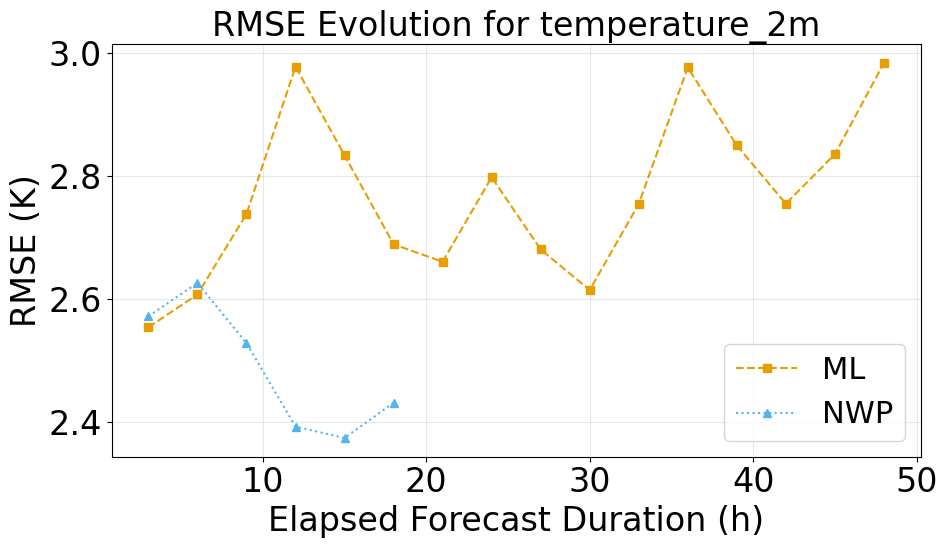

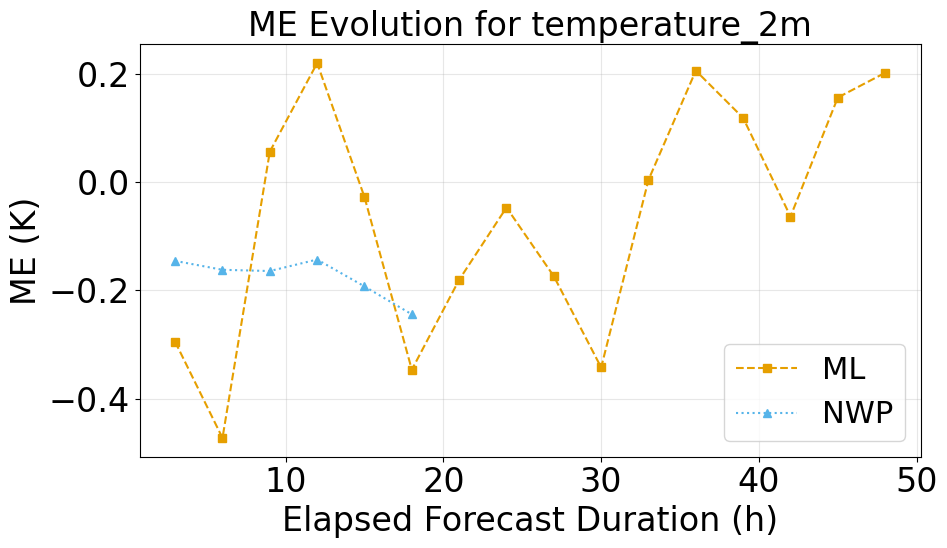

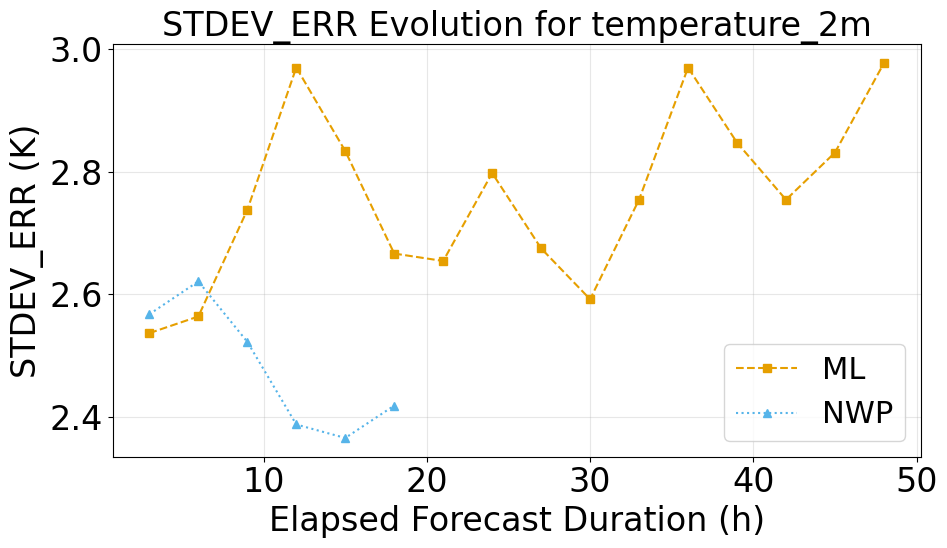

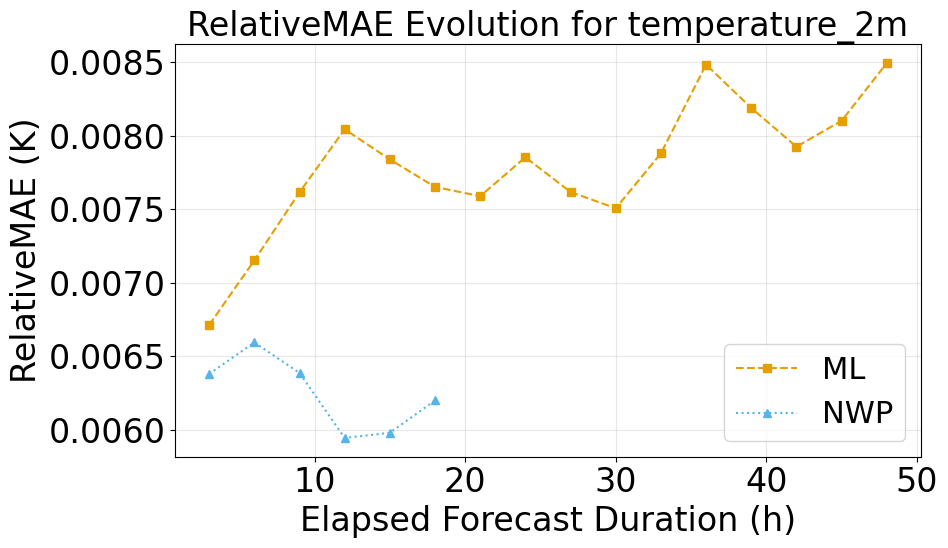

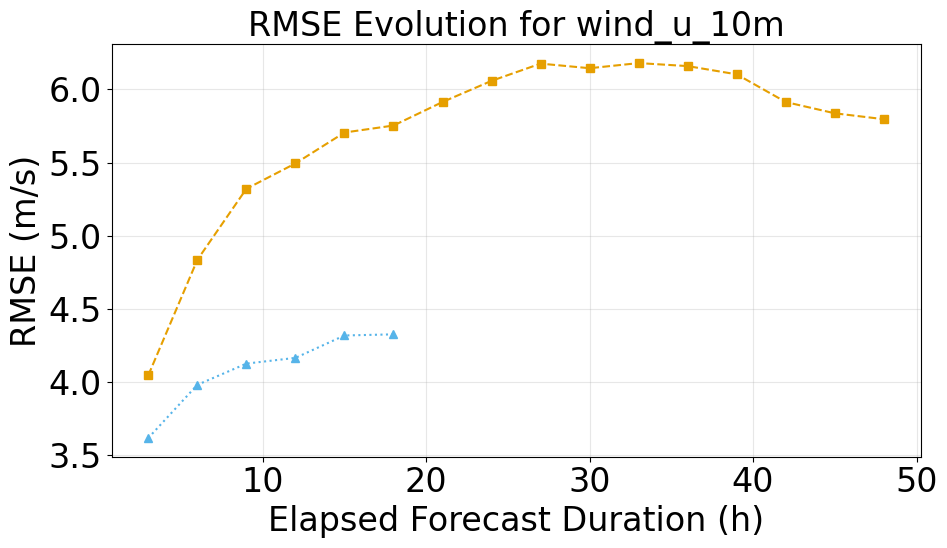

...

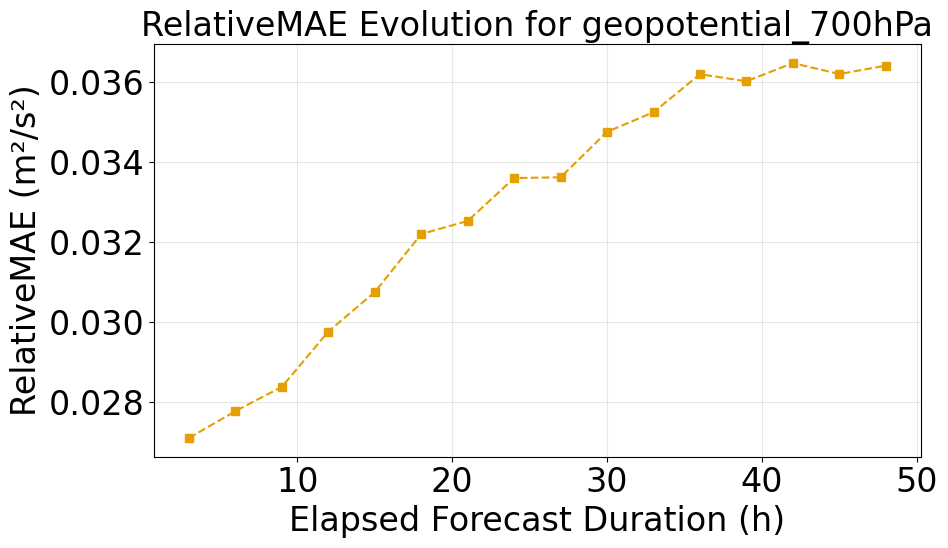

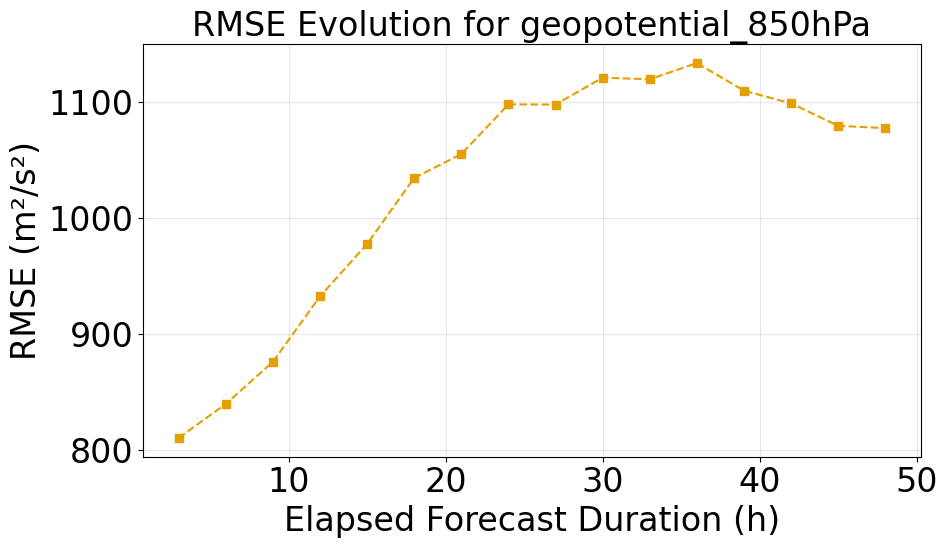

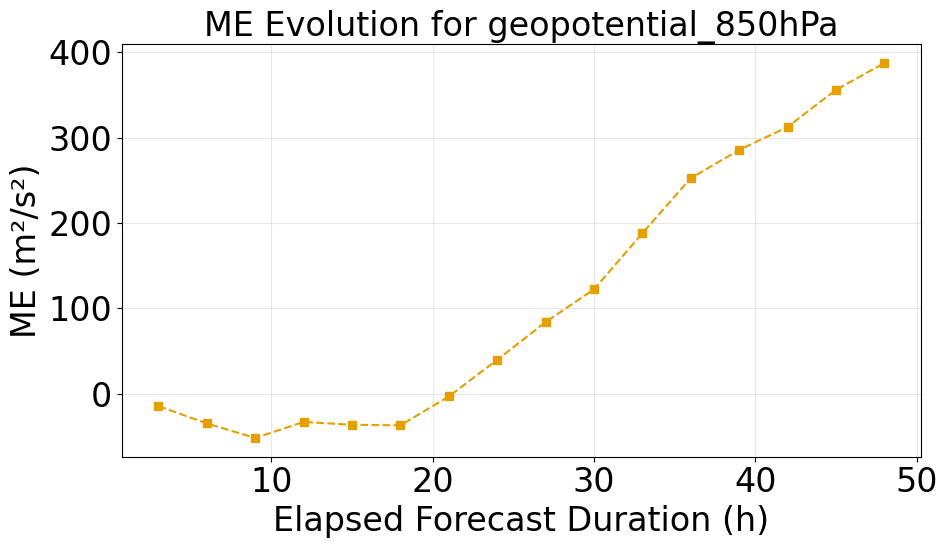

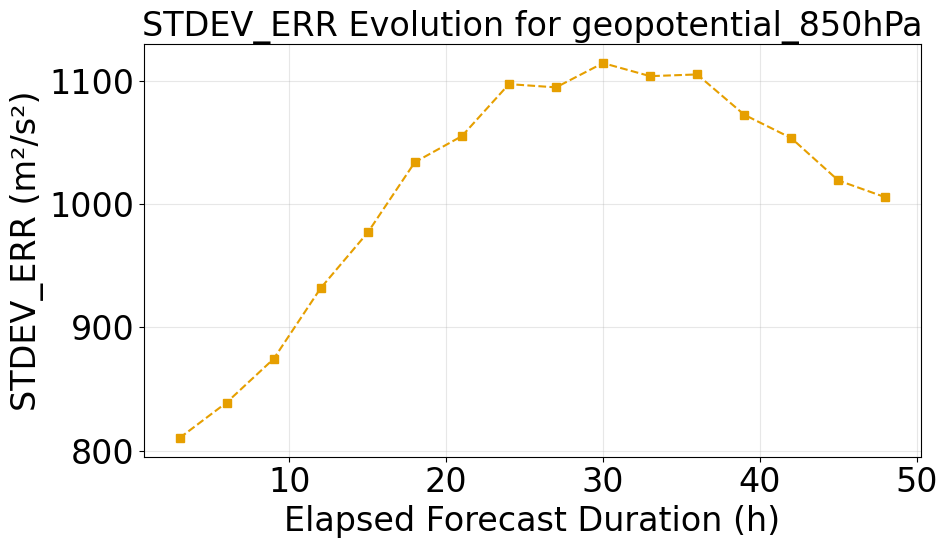

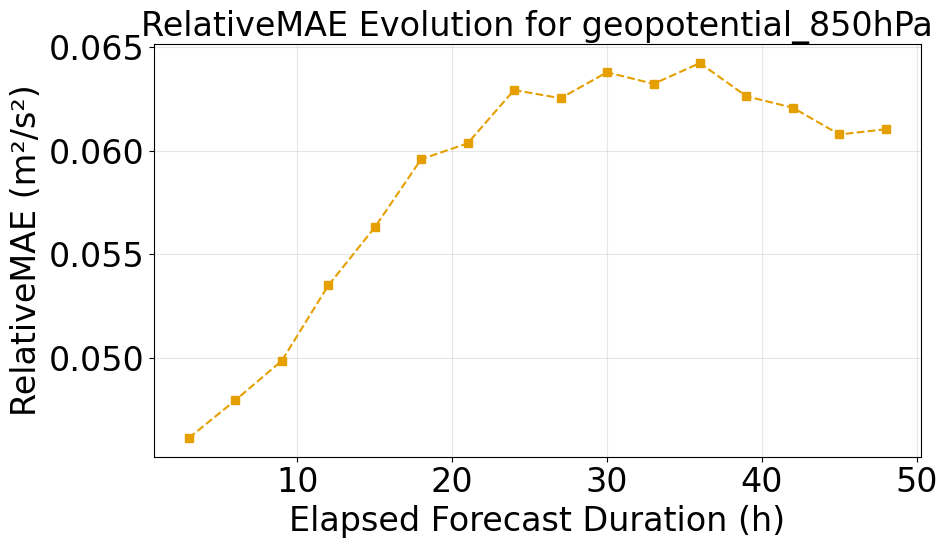

In [28]:
# Plot evolution of a specific metric over elapsed forecast duration
elapsed_forecast_durations = list(metrics_by_efd.keys())
for i, variable in enumerate(VARIABLES_GROUND_TRUTH.values()):
    for metric in METRICS:
        try:
            # Skip if any scores are missing
            ml_scores = [
                df.loc[variable, f"{metric} ML"]
                for df in metrics_by_efd.values()
            ]

            # Convert elapsed forecast durations from hours to timedelta
            hours = [
                x / np.timedelta64(1, "h")
                for x in ds_ml.elapsed_forecast_duration.values
            ]

            fig, ax = plt.subplots(figsize=(10, 6), dpi=DPI)

            # Plot ML scores
            ax.plot(
                hours,
                ml_scores,
                label="ML" if i == 0 else "",
                color=COLORS["ml"],
                linestyle=LINE_STYLES["ml"][0],
                marker=LINE_STYLES["ml"][1],
            )

            nwp_metric_name = f"{metric} NWP"
            nwp_scores = [
                df.loc[variable, nwp_metric_name]
                for df in metrics_by_efd.values() if nwp_metric_name in df
            ]

            # Plot NWP scores if they exist and are not all NaN
            if nwp_scores and not all(pd.isna(nwp_scores)):
                hours_nwp = [
                    x / np.timedelta64(1, "h")
                    for x in ds_nwp.elapsed_forecast_duration.values
                ]

                ax.plot(
                    hours_nwp,
                    nwp_scores,
                    label="NWP" if i == 0 else "",
                    color=COLORS["nwp"],
                    linestyle=LINE_STYLES["nwp"][0],
                    marker=LINE_STYLES["nwp"][1],
                )

            ax.set_xlabel("Elapsed Forecast Duration (h)")
            ax.set_ylabel(f"{metric} ({VARIABLE_UNITS[variable]})")
            ax.set_title(f"{metric} Evolution for {variable}")
            ax.grid(True, alpha=0.3)

            # Only show legend for first variable
            if i == 0:
                ax.legend()

            plt.tight_layout()
            plt.show()
            save_plot(fig, f"{metric}_{variable}_evolution")
            plt.close()

        except (KeyError, ValueError) as e:
            print(f"Skipping {metric} for {variable}: {str(e)}")
            continue


#### Equitable Threat Score (Traditional Version)
Range: [-1/3, 1], where:
- 1 = perfect score
- 0 = no skill compared to random chance
- -1/3 = worst possible performance

**Key Properties:**
- Measures how well predicted events correspond to observed events, accounting for hits due to random chance
- Particularly useful for rare events (like precipitation above a high threshold)
- More equitable than simple Threat Score by accounting for hits due to random chance

**Advantages:**
- Well-established metric in meteorological verification
- Reference point at 0 makes interpretation clear
- Penalizes both misses and false alarms
- Accounts for random chance, making it more robust than basic threat scores

#### Frequency Bias Index
Range: 0 to infinity, where:
- 1 = no bias
- < 1 = underforecasting
- > 1 = overforecasting

**Key Properties:**
- FBI measures the ratio of observed to forecasted events, indicating whether the model tends to over- or underforecast
- It's particularly useful for understanding systematic biases in event frequency

**Advantages:**
- Provides a clear indication of over- or underforecasting
- Easy to interpret: 1 indicates no bias, while values above or below 1 show the direction and magnitude of the bias

In [29]:
# Set display options for all float values
pd.set_option("display.float_format", lambda x: "{:.4f}".format(x))

In [30]:
def calculate_meteoswiss_metrics(ds_gt, ds_ml, ds_nwp):
    """Calculate MeteoSwiss verification metrics"""
    metrics_by_var = {}

    # Get available variables in each dataset
    gt_ml_vars = set(ds_gt.variables) & set(ds_ml.variables)
    nwp_vars = set(ds_nwp.variables) if ds_nwp is not None else set()

    all_variables = {
        "precipitation": {
            "thresholds": THRESHOLDS_PRECIPITATION,
            "unit": "mm/h",
        },
        "wind_u_10m": {"thresholds": THRESHOLDS_WIND, "unit": "m/s"},
        "wind_v_10m": {"thresholds": THRESHOLDS_WIND, "unit": "m/s"},
    }

    # Filter variables that exist in gt and ml
    all_variables = {k: v for k, v in all_variables.items() if k in gt_ml_vars}

    # Initialize metrics structure
    for var_name in all_variables:
        metrics_by_var[var_name] = {}
        for thr in all_variables[var_name]["thresholds"]:
            metric_key = f"{thr}{all_variables[var_name]['unit']}"
            metrics_by_var[var_name][metric_key] = {
                "FBI_ML": [],
                "ETS_ML": [],
                "FBI_NWP": [] if ds_nwp is not None else None,
                "ETS_NWP": [] if ds_nwp is not None else None,
            }

    for efd in ds_ml.elapsed_forecast_duration.values:
        try:
            print(
                f"\nCalculating metrics for elapsed forecast duration: {efd / np.timedelta64(1, 'h'):.1f}h"
            )

            ds_ml_lead = ds_ml.sel(elapsed_forecast_duration=efd)
            ds_nwp_lead = (
                ds_nwp.sel(elapsed_forecast_duration=efd)
                if ds_nwp is not None
                else None
            )
            forecast_times = ds_ml_lead.forecast_time.values.flatten()
            ds_gt_lead = ds_gt.sel(time=forecast_times)

            for var_name, var_config in all_variables.items():
                print(f"Processing {var_name}")
                try:
                    # Get data
                    y_true = ds_gt_lead[var_name]
                    y_ml = ds_ml_lead[var_name]
                    y_nwp = (
                        ds_nwp_lead[var_name]
                        if ds_nwp_lead is not None and var_name in nwp_vars
                        else None
                    )

                    for thr in var_config["thresholds"]:
                        metric_key = f"{thr}{var_config['unit']}"

                        # Calculate ML metrics using TEO
                        event_operator = TEO(default_event_threshold=thr)
                        ml_contingency = (
                            event_operator.make_contingency_manager(
                                y_ml, y_true
                            )
                        )

                        fbi_ml = ml_contingency.frequency_bias().values
                        ets_ml = ml_contingency.equitable_threat_score().values

                        metrics_by_var[var_name][metric_key]["FBI_ML"].append(
                            fbi_ml
                        )
                        metrics_by_var[var_name][metric_key]["ETS_ML"].append(
                            ets_ml
                        )

                        # Calculate NWP metrics if available
                        if y_nwp is not None:
                            nwp_contingency = (
                                event_operator.make_contingency_manager(
                                    y_nwp, y_true
                                )
                            )
                            fbi_nwp = nwp_contingency.frequency_bias().values
                            ets_nwp = (
                                nwp_contingency.equitable_threat_score().values
                            )

                            metrics_by_var[var_name][metric_key][
                                "FBI_NWP"
                            ].append(fbi_nwp)
                            metrics_by_var[var_name][metric_key][
                                "ETS_NWP"
                            ].append(ets_nwp)

                except Exception as e:
                    print(f"Error processing {var_name}: {str(e)}")
                    continue

        except Exception as e:
            print(f"Error processing elapsed forecast duration {efd}: {str(e)}")
            continue

    return metrics_by_var

def plot_metrics_evolution(
    metrics_by_var,
    elapsed_forecast_durations,
    var_name,
    metric_name,
    var_index=0,
):
    """Plot evolution of FBI/ETS metrics over elapsed forecast durations for gridded data."""
    try:
        if not metrics_by_var or var_name not in metrics_by_var:
            print(f"No metrics data available for {var_name}")
            return

        # Convert timedelta to hours for x-axis
        forecast_hours = [
            efd / np.timedelta64(1, "h") for efd in elapsed_forecast_durations
        ]

        # Get three fixed colors from viridis
        colors = [plt.cm.viridis(x) for x in [0, 0.5, 0.99]]

        fig, ax = plt.subplots(figsize=(10, 6), dpi=DPI)

        # Plot for each threshold
        for i, (threshold, metrics) in enumerate(
            metrics_by_var[var_name].items()
        ):
            # Plot ML metrics
            if metrics["FBI_ML"]:  # Check if we have ML metrics
                ax.plot(
                    forecast_hours,
                    metrics[f"{metric_name}_ML"],
                    linestyle=LINE_STYLES["ml"][0],
                    marker=LINE_STYLES["ml"][1],
                    color=colors[i],
                    label=f"ML {threshold}" if var_index == 0 else "",
                )

            # Plot NWP metrics if available
            if metrics[f"{metric_name}_NWP"]:  # Check if we have NWP metrics
                ax.plot(
                    forecast_hours,
                    metrics[f"{metric_name}_NWP"],
                    linestyle=LINE_STYLES["nwp"][0],
                    marker=LINE_STYLES["nwp"][1],
                    color=colors[i],
                    label=f"NWP {threshold}" if var_index == 0 else "",
                )

        ax.set_xlabel("Elapsed Forecast Duration (h)")
        ax.set_ylabel(metric_name)
        ax.set_title(f"{metric_name} Evolution for {var_name}")
        ax.grid(True, alpha=0.3)

        # Only show legend for first variable
        if var_index == 0:
            ax.legend()

        plt.tight_layout()
        plt.show()
        save_plot(fig, f"{metric_name.lower()}_{var_name}_evolution")
        plt.close()

    except Exception as e:
        print(f"Error plotting {var_name} - {metric_name}: {str(e)}")

Calculating MeteoSwiss metrics...

Calculating metrics for elapsed forecast duration: 3.0h
Processing wind_u_10m
Processing wind_v_10m

Calculating metrics for elapsed forecast duration: 6.0h
Processing wind_u_10m
Processing wind_v_10m

Calculating metrics for elapsed forecast duration: 9.0h
Processing wind_u_10m
Processing wind_v_10m

Calculating metrics for elapsed forecast duration: 12.0h
Processing wind_u_10m
Processing wind_v_10m

Calculating metrics for elapsed forecast duration: 15.0h
Processing wind_u_10m
Processing wind_v_10m

Calculating metrics for elapsed forecast duration: 18.0h
Processing wind_u_10m
Processing wind_v_10m


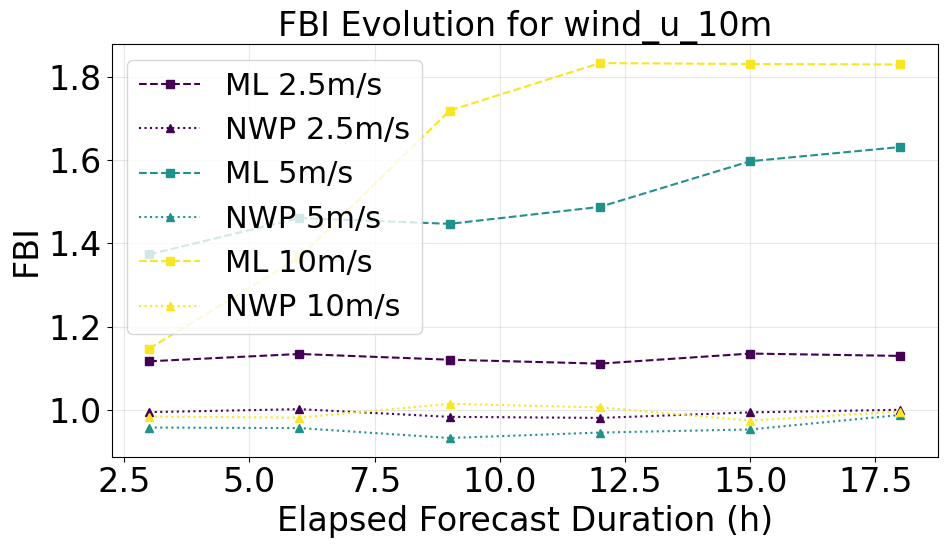

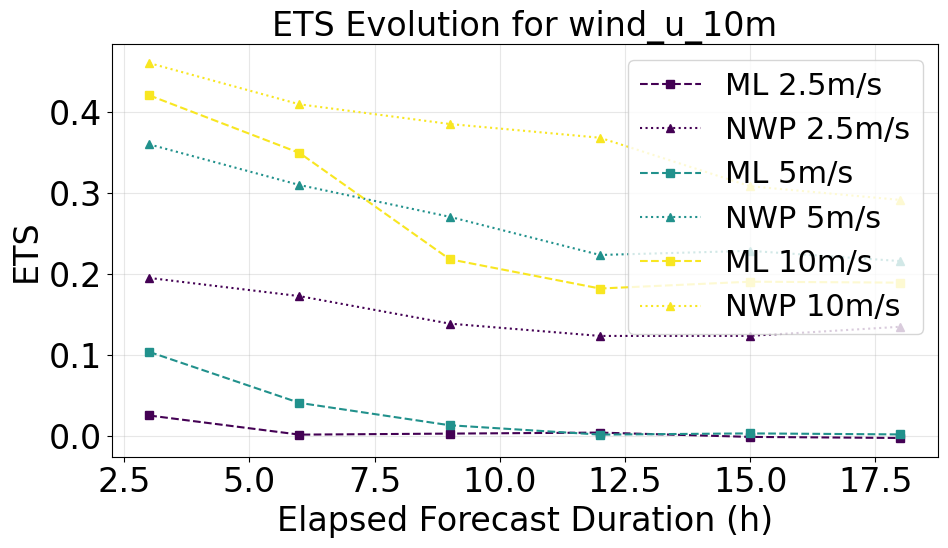

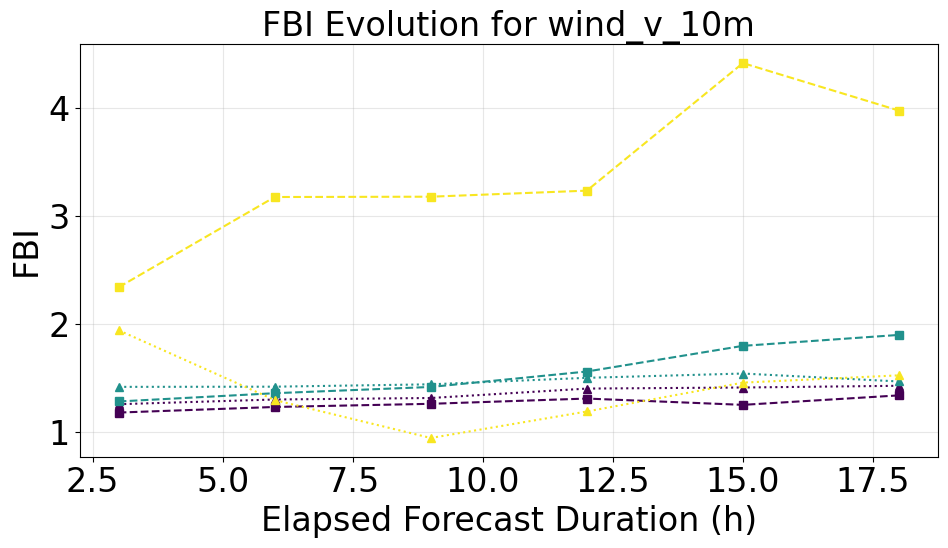

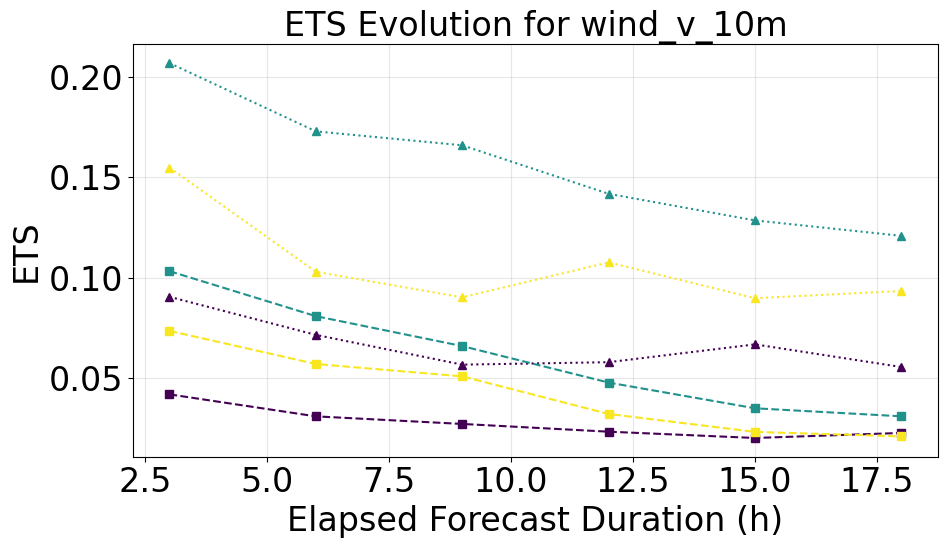

In [31]:
def reshape_metrics_by_var(metrics_by_var, elapsed_forecast_durations):
    """Reshape the metrics dictionary into a DataFrame with thresholds as columns"""
    # Convert forecast durations to hours for index
    forecast_hours = [
        efd / np.timedelta64(1, "h") for efd in elapsed_forecast_durations
    ]

    # Create a list to store all data
    data = []

    # Iterate through each forecast hour
    for idx, hour in enumerate(forecast_hours):
        row_data = {"forecast_hour": hour}

        # Iterate through each variable and its thresholds
        for var_name, thresholds in metrics_by_var.items():
            for threshold, metrics in thresholds.items():
                # Add ML metrics if they exist and have values
                if metrics["FBI_ML"] is not None:
                    row_data[f"{var_name}_{threshold}_FBI_ML"] = metrics[
                        "FBI_ML"
                    ][idx]
                    row_data[f"{var_name}_{threshold}_ETS_ML"] = metrics[
                        "ETS_ML"
                    ][idx]

                # Add NWP metrics if they exist and have values
                if metrics["FBI_NWP"] is not None:
                    row_data[f"{var_name}_{threshold}_FBI_NWP"] = metrics[
                        "FBI_NWP"
                    ][idx]
                    row_data[f"{var_name}_{threshold}_ETS_NWP"] = metrics[
                        "ETS_NWP"
                    ][idx]

        data.append(row_data)

    # Create DataFrame from collected data
    df = pd.DataFrame(data)
    df.set_index("forecast_hour", inplace=True)
    return df


# Modify the main execution block:
try:
    print("Calculating MeteoSwiss metrics...")
    metrics_by_var = calculate_meteoswiss_metrics(
        ds_gt,
        ds_ml_sampled.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_SHORT),
        ds_nwp_sampled.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_SHORT)
    )

    # Reshape and export metrics to table
    elapsed_forecast_durations = ds_ml.isel(elapsed_forecast_duration=ELAPSED_FORECAST_DURATION_SHORT).elapsed_forecast_duration.values
    metrics_df = reshape_metrics_by_var(
        metrics_by_var, elapsed_forecast_durations
    )

    export_table(
        metrics_df,
        "meteoswiss_metrics",
        "MeteoSwiss verification metrics (FBI and ETS)",
    )

    # Plot metrics for each variable
    for i, var_name in enumerate(metrics_by_var):
        for metric_name in ["FBI", "ETS"]:
            plot_metrics_evolution(
                metrics_by_var,
                elapsed_forecast_durations,
                var_name,
                metric_name,
                var_index=i
            )

except Exception as e:
    print(f"Error in main execution: {str(e)}")


The wind vector RMSE takes into account the magnitude and direction of the wind, providing a more comprehensive measure of error than scalar metrics.

Calculating wind vector RMSE for EFD: 10800000000000 nanoseconds
Calculating wind vector RMSE for EFD: 21600000000000 nanoseconds
Calculating wind vector RMSE for EFD: 32400000000000 nanoseconds
Calculating wind vector RMSE for EFD: 43200000000000 nanoseconds
Calculating wind vector RMSE for EFD: 54000000000000 nanoseconds
Calculating wind vector RMSE for EFD: 64800000000000 nanoseconds
Calculating wind vector RMSE for EFD: 75600000000000 nanoseconds
Calculating wind vector RMSE for EFD: 86400000000000 nanoseconds
Calculating wind vector RMSE for EFD: 97200000000000 nanoseconds
Calculating wind vector RMSE for EFD: 108000000000000 nanoseconds
Calculating wind vector RMSE for EFD: 118800000000000 nanoseconds
Calculating wind vector RMSE for EFD: 129600000000000 nanoseconds
Calculating wind vector RMSE for EFD: 140400000000000 nanoseconds
Calculating wind vector RMSE for EFD: 151200000000000 nanoseconds
Calculating wind vector RMSE for EFD: 162000000000000 nanoseconds
Calculating wind ve

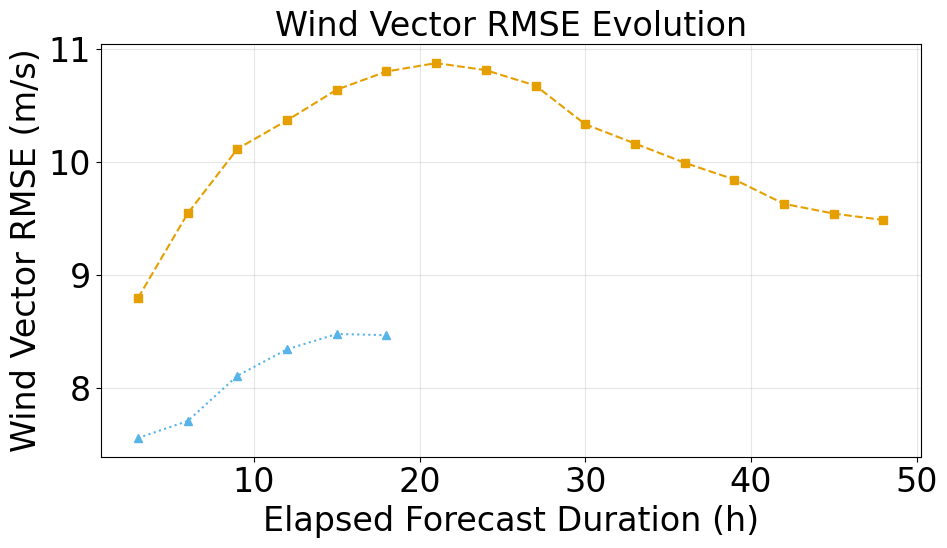

In [32]:
def wind_vector_rmse(u_pred, v_pred, u_true, v_true):
    """Calculate RMSE based on wind vector differences."""
    rmse_u = rmse(u_true, u_pred)
    rmse_v = rmse(v_true, v_pred)
    rmse_wind = np.sqrt(rmse_u**2 + rmse_v**2)
    return float(rmse_wind)


# Initialize results dictionary
results_wind = {"vector_metrics": {}}
elapsed_forecast_durations = ds_ml_sampled.elapsed_forecast_duration.values

# Lists to store RMSE values over time
ml_rmse_over_time = []
nwp_rmse_over_time = []
forecast_hours = [
    efd / np.timedelta64(1, "h") for efd in elapsed_forecast_durations
]

if "wind_u_10m" in ds_gt and "wind_v_10m" in ds_gt:
    for efd in elapsed_forecast_durations:
        print(f"Calculating wind vector RMSE for EFD: {efd}")
        # Get corresponding forecast times
        forecast_times = ds_ml_sampled.sel(
            elapsed_forecast_duration=efd
        ).forecast_time.values

        # Get wind components for specific forecast time
        u_true = ds_gt["wind_u_10m"].sel(time=forecast_times)
        v_true = ds_gt["wind_v_10m"].sel(time=forecast_times)
        u_ml = ds_ml_sampled["wind_u_10m"].sel(elapsed_forecast_duration=efd)
        v_ml = ds_ml_sampled["wind_v_10m"].sel(elapsed_forecast_duration=efd)

        # Calculate ML RMSE
        wind_rmse_ml = wind_vector_rmse(u_ml, v_ml, u_true, v_true)
        ml_rmse_over_time.append(wind_rmse_ml)

        # Calculate NWP RMSE if available
        if ("wind_u_10m" in ds_nwp 
            and "wind_v_10m" in ds_nwp
            and efd in ds_nwp_sampled.elapsed_forecast_duration
        ):
            u_nwp = ds_nwp_sampled["wind_u_10m"].sel(elapsed_forecast_duration=efd)
            v_nwp = ds_nwp_sampled["wind_v_10m"].sel(elapsed_forecast_duration=efd)
            wind_rmse_nwp = wind_vector_rmse(u_nwp, v_nwp, u_true, v_true)
            nwp_rmse_over_time.append(wind_rmse_nwp)
        else:
            nwp_rmse_over_time.append(np.nan)

    # Create time series DataFrame
    time_series_df = pd.DataFrame({
        "Elapsed Forecast Duration": forecast_hours,
        "ML RMSE": ml_rmse_over_time,
        "NWP RMSE": nwp_rmse_over_time,
    })

    # Plot RMSE over time
    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot ML model
    ax.plot(
        forecast_hours,
        ml_rmse_over_time,
        linestyle=LINE_STYLES["ml"][0],
        marker=LINE_STYLES["ml"][1],
        label="ML",
        color=COLORS["ml"],
    )

    # Plot NWP model if available
    if not all(np.isnan(nwp_rmse_over_time)):
        ax.plot(
            forecast_hours,
            nwp_rmse_over_time,
            linestyle=LINE_STYLES["nwp"][0],
            marker=LINE_STYLES["nwp"][1],
            label="NWP",
            color=COLORS["nwp"],
        )

    ax.set_xlabel("Elapsed Forecast Duration (h)")
    ax.set_ylabel("Wind Vector RMSE (m/s)")
    ax.set_title("Wind Vector RMSE Evolution")
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()
    save_plot(fig, "wind_vector_rmse_evolution")

    export_table(
        time_series_df,
        "wind_vector_metrics_timeseries",
        caption="Wind vector RMSE over forecast duration",
    )
